# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

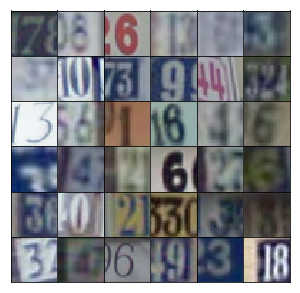

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        # reshape
        x = tf.reshape(x, (-1, 4, 4, 512))
        # apply batch normalisation
        x = tf.layers.batch_normalization(x, training=training)
        # apply Leaky ReLU
        x = tf.maximum(x*alpha, x)
                
        # First conv layer 8,8,256 ***may want to set use_bias to True****
        x1 = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding="same")
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(x1*alpha, x1)
        
        # Second conv layer 16,16,128
        x2 = tf.layers.conv2d_transpose(x1, 128, 5, strides=2, padding="same")
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(x2*alpha, x2)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x2, output_dim, 5, strides=2, padding="same")
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        # first conv layer 16,16,64
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding="same")
        x = tf.maximum(x*alpha, x)
        
        # conv layer 1 8,8,128
        x1 = tf.layers.conv2d(x, 128, 5, strides=2, padding="same")
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(x1*alpha, x1)
        
        # conv layer 2 4,4,256
        x2 = tf.layers.conv2d(x1, 256, 5, strides=2, padding="same")
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(x2*alpha, x2)
        
        flatten = tf.reshape(x2, (-1, 4*4*256))
        
        logits = tf.layers.dense(flatten, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, 'checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [ ]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.8168... Generator Loss: 1.2524
Epoch 1/25... Discriminator Loss: 0.2730... Generator Loss: 2.5479
Epoch 1/25... Discriminator Loss: 0.1361... Generator Loss: 2.6607
Epoch 1/25... Discriminator Loss: 0.1463... Generator Loss: 2.6146
Epoch 1/25... Discriminator Loss: 0.1394... Generator Loss: 3.0345
Epoch 1/25... Discriminator Loss: 0.0963... Generator Loss: 3.0956
Epoch 1/25... Discriminator Loss: 0.1207... Generator Loss: 4.1328
Epoch 1/25... Discriminator Loss: 0.1026... Generator Loss: 3.6093
Epoch 1/25... Discriminator Loss: 0.2165... Generator Loss: 2.4466
Epoch 1/25... Discriminator Loss: 0.1016... Generator Loss: 3.5440


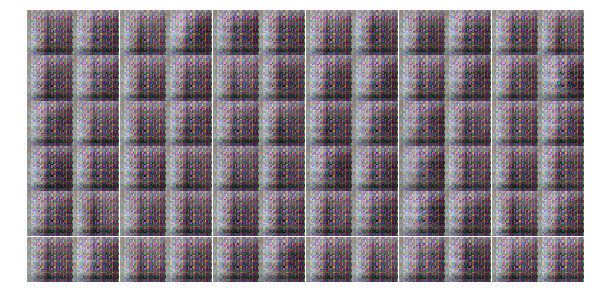

Epoch 1/25... Discriminator Loss: 2.0748... Generator Loss: 6.4872
Epoch 1/25... Discriminator Loss: 0.6241... Generator Loss: 1.9705
Epoch 1/25... Discriminator Loss: 0.8526... Generator Loss: 2.6449
Epoch 1/25... Discriminator Loss: 0.3834... Generator Loss: 1.5578
Epoch 1/25... Discriminator Loss: 0.4586... Generator Loss: 1.7852
Epoch 1/25... Discriminator Loss: 0.7537... Generator Loss: 4.2130
Epoch 1/25... Discriminator Loss: 1.2239... Generator Loss: 3.2298
Epoch 1/25... Discriminator Loss: 0.5736... Generator Loss: 1.7567
Epoch 1/25... Discriminator Loss: 0.3468... Generator Loss: 2.1682
Epoch 1/25... Discriminator Loss: 0.2174... Generator Loss: 2.6258


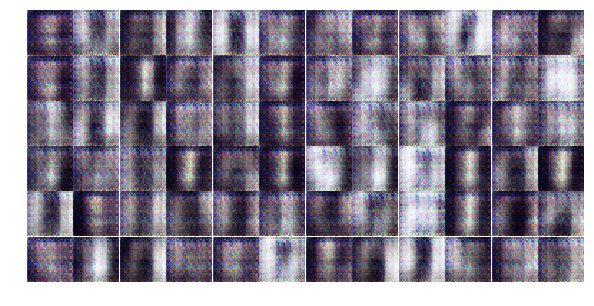

Epoch 1/25... Discriminator Loss: 0.8182... Generator Loss: 0.8927
Epoch 1/25... Discriminator Loss: 0.0707... Generator Loss: 4.6282
Epoch 1/25... Discriminator Loss: 0.7052... Generator Loss: 1.3203
Epoch 1/25... Discriminator Loss: 0.5143... Generator Loss: 4.7171
Epoch 1/25... Discriminator Loss: 0.1572... Generator Loss: 3.5530
Epoch 1/25... Discriminator Loss: 0.1274... Generator Loss: 3.5385
Epoch 1/25... Discriminator Loss: 1.5596... Generator Loss: 1.0050
Epoch 1/25... Discriminator Loss: 1.1340... Generator Loss: 0.9903
Epoch 1/25... Discriminator Loss: 0.7326... Generator Loss: 2.5499
Epoch 1/25... Discriminator Loss: 0.7075... Generator Loss: 2.1604


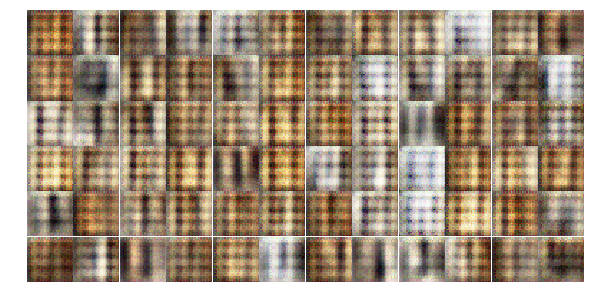

Epoch 1/25... Discriminator Loss: 0.7634... Generator Loss: 1.3960
Epoch 1/25... Discriminator Loss: 0.7442... Generator Loss: 1.3609
Epoch 1/25... Discriminator Loss: 0.7517... Generator Loss: 1.0778
Epoch 1/25... Discriminator Loss: 0.3327... Generator Loss: 2.3111
Epoch 1/25... Discriminator Loss: 0.5018... Generator Loss: 1.8945
Epoch 1/25... Discriminator Loss: 0.4824... Generator Loss: 1.7464
Epoch 1/25... Discriminator Loss: 0.3471... Generator Loss: 2.2421
Epoch 1/25... Discriminator Loss: 0.2790... Generator Loss: 2.1923
Epoch 1/25... Discriminator Loss: 1.0524... Generator Loss: 1.7736
Epoch 1/25... Discriminator Loss: 0.2951... Generator Loss: 2.2456


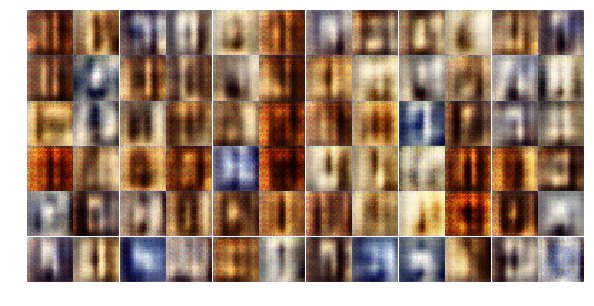

Epoch 1/25... Discriminator Loss: 0.3817... Generator Loss: 2.0336
Epoch 1/25... Discriminator Loss: 0.2276... Generator Loss: 3.0777
Epoch 1/25... Discriminator Loss: 0.4285... Generator Loss: 1.9561
Epoch 1/25... Discriminator Loss: 0.7698... Generator Loss: 2.0644
Epoch 1/25... Discriminator Loss: 0.9333... Generator Loss: 0.8846
Epoch 1/25... Discriminator Loss: 0.4294... Generator Loss: 1.8875
Epoch 1/25... Discriminator Loss: 0.3718... Generator Loss: 1.8304
Epoch 1/25... Discriminator Loss: 0.8352... Generator Loss: 2.6526
Epoch 1/25... Discriminator Loss: 0.3607... Generator Loss: 1.8119
Epoch 1/25... Discriminator Loss: 0.5252... Generator Loss: 1.2692


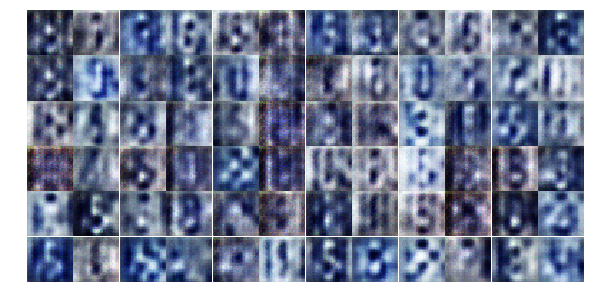

Epoch 1/25... Discriminator Loss: 0.2050... Generator Loss: 2.2915
Epoch 1/25... Discriminator Loss: 1.0831... Generator Loss: 0.8577
Epoch 1/25... Discriminator Loss: 0.3258... Generator Loss: 2.2293
Epoch 1/25... Discriminator Loss: 1.1713... Generator Loss: 0.5808
Epoch 1/25... Discriminator Loss: 1.3036... Generator Loss: 0.6372
Epoch 1/25... Discriminator Loss: 0.8815... Generator Loss: 0.9690
Epoch 1/25... Discriminator Loss: 0.3181... Generator Loss: 2.0940
Epoch 2/25... Discriminator Loss: 0.3992... Generator Loss: 2.4802
Epoch 2/25... Discriminator Loss: 0.2510... Generator Loss: 2.3493
Epoch 2/25... Discriminator Loss: 0.2204... Generator Loss: 3.2869


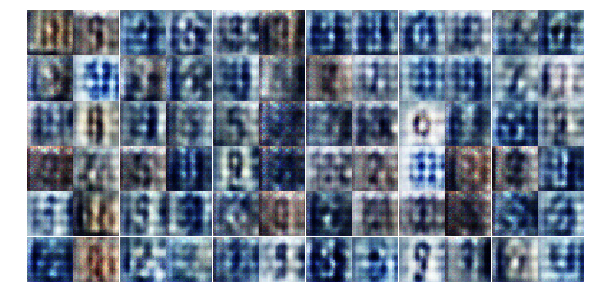

Epoch 2/25... Discriminator Loss: 0.6452... Generator Loss: 1.1302
Epoch 2/25... Discriminator Loss: 1.2116... Generator Loss: 0.7091
Epoch 2/25... Discriminator Loss: 0.7727... Generator Loss: 1.0747
Epoch 2/25... Discriminator Loss: 0.4428... Generator Loss: 1.6452
Epoch 2/25... Discriminator Loss: 1.7427... Generator Loss: 3.0648
Epoch 2/25... Discriminator Loss: 0.3333... Generator Loss: 1.7325
Epoch 2/25... Discriminator Loss: 0.4753... Generator Loss: 1.4682
Epoch 2/25... Discriminator Loss: 0.8528... Generator Loss: 1.2005
Epoch 2/25... Discriminator Loss: 0.7143... Generator Loss: 1.2100
Epoch 2/25... Discriminator Loss: 0.7803... Generator Loss: 1.2901


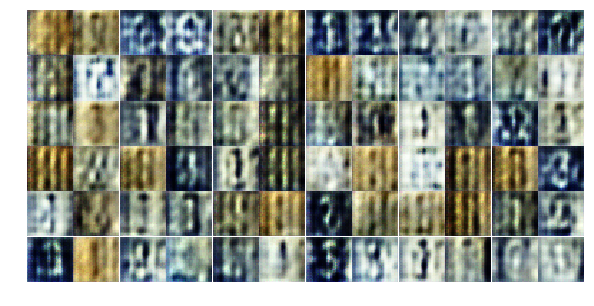

Epoch 2/25... Discriminator Loss: 0.9310... Generator Loss: 1.4668
Epoch 2/25... Discriminator Loss: 1.2546... Generator Loss: 3.3373
Epoch 2/25... Discriminator Loss: 1.0288... Generator Loss: 1.0971
Epoch 2/25... Discriminator Loss: 1.0974... Generator Loss: 1.0058
Epoch 2/25... Discriminator Loss: 0.9774... Generator Loss: 1.5033
Epoch 2/25... Discriminator Loss: 0.7076... Generator Loss: 1.4508
Epoch 2/25... Discriminator Loss: 0.9884... Generator Loss: 1.3950
Epoch 2/25... Discriminator Loss: 0.8084... Generator Loss: 1.1028
Epoch 2/25... Discriminator Loss: 0.7573... Generator Loss: 1.3435
Epoch 2/25... Discriminator Loss: 1.1571... Generator Loss: 0.6340


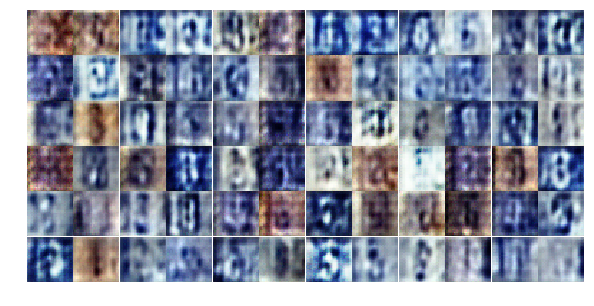

Epoch 2/25... Discriminator Loss: 0.8814... Generator Loss: 1.3672
Epoch 2/25... Discriminator Loss: 0.8235... Generator Loss: 1.4218
Epoch 2/25... Discriminator Loss: 0.7312... Generator Loss: 1.4470
Epoch 2/25... Discriminator Loss: 0.8706... Generator Loss: 1.9751
Epoch 2/25... Discriminator Loss: 0.6399... Generator Loss: 1.8858
Epoch 2/25... Discriminator Loss: 0.6796... Generator Loss: 1.3937
Epoch 2/25... Discriminator Loss: 1.0905... Generator Loss: 0.6461
Epoch 2/25... Discriminator Loss: 0.8191... Generator Loss: 1.0612
Epoch 2/25... Discriminator Loss: 1.1594... Generator Loss: 1.0596
Epoch 2/25... Discriminator Loss: 1.0723... Generator Loss: 1.1569


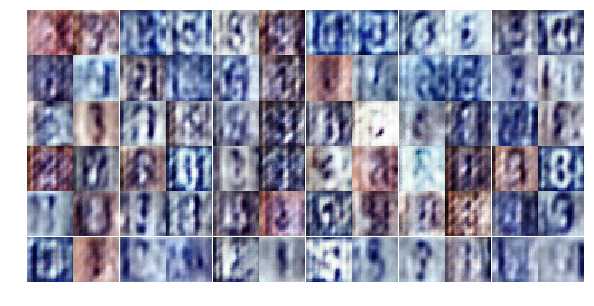

Epoch 2/25... Discriminator Loss: 1.4666... Generator Loss: 1.3239
Epoch 2/25... Discriminator Loss: 1.1206... Generator Loss: 0.9305
Epoch 2/25... Discriminator Loss: 1.1064... Generator Loss: 0.8531
Epoch 2/25... Discriminator Loss: 1.3838... Generator Loss: 0.5045
Epoch 2/25... Discriminator Loss: 1.2456... Generator Loss: 1.4561
Epoch 2/25... Discriminator Loss: 1.0757... Generator Loss: 1.0681
Epoch 2/25... Discriminator Loss: 1.3775... Generator Loss: 0.7238
Epoch 2/25... Discriminator Loss: 1.0693... Generator Loss: 1.2157
Epoch 2/25... Discriminator Loss: 1.1093... Generator Loss: 1.2875
Epoch 2/25... Discriminator Loss: 1.1548... Generator Loss: 0.9971


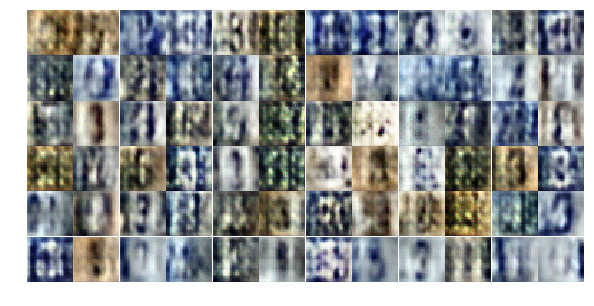

Epoch 2/25... Discriminator Loss: 0.8834... Generator Loss: 1.3733
Epoch 2/25... Discriminator Loss: 0.9980... Generator Loss: 1.2643
Epoch 2/25... Discriminator Loss: 1.0027... Generator Loss: 0.8981
Epoch 2/25... Discriminator Loss: 0.8318... Generator Loss: 1.1533
Epoch 2/25... Discriminator Loss: 1.1441... Generator Loss: 0.7743
Epoch 2/25... Discriminator Loss: 1.3783... Generator Loss: 0.5491
Epoch 2/25... Discriminator Loss: 0.8701... Generator Loss: 1.3526
Epoch 2/25... Discriminator Loss: 0.9525... Generator Loss: 0.9615
Epoch 2/25... Discriminator Loss: 0.7001... Generator Loss: 1.4473
Epoch 2/25... Discriminator Loss: 0.8907... Generator Loss: 1.2967


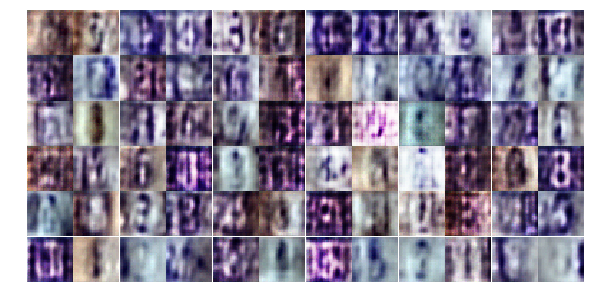

Epoch 2/25... Discriminator Loss: 1.0311... Generator Loss: 1.3963
Epoch 2/25... Discriminator Loss: 1.0307... Generator Loss: 1.0392
Epoch 2/25... Discriminator Loss: 1.0129... Generator Loss: 0.8797
Epoch 2/25... Discriminator Loss: 1.0003... Generator Loss: 0.9981
Epoch 3/25... Discriminator Loss: 1.0150... Generator Loss: 1.5371
Epoch 3/25... Discriminator Loss: 0.8954... Generator Loss: 0.9831
Epoch 3/25... Discriminator Loss: 0.7009... Generator Loss: 1.4296
Epoch 3/25... Discriminator Loss: 1.2143... Generator Loss: 0.6748
Epoch 3/25... Discriminator Loss: 0.7037... Generator Loss: 1.1593
Epoch 3/25... Discriminator Loss: 1.1035... Generator Loss: 0.7257


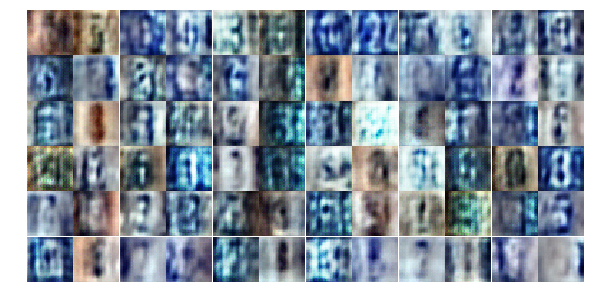

Epoch 3/25... Discriminator Loss: 0.8361... Generator Loss: 1.0954
Epoch 3/25... Discriminator Loss: 0.8960... Generator Loss: 0.9363
Epoch 3/25... Discriminator Loss: 0.8739... Generator Loss: 0.9709
Epoch 3/25... Discriminator Loss: 0.6790... Generator Loss: 1.3416
Epoch 3/25... Discriminator Loss: 0.7946... Generator Loss: 1.0634
Epoch 3/25... Discriminator Loss: 1.0578... Generator Loss: 0.8835
Epoch 3/25... Discriminator Loss: 0.9191... Generator Loss: 1.0076
Epoch 3/25... Discriminator Loss: 0.6424... Generator Loss: 1.8907
Epoch 3/25... Discriminator Loss: 0.7207... Generator Loss: 1.4645
Epoch 3/25... Discriminator Loss: 1.0051... Generator Loss: 0.9156


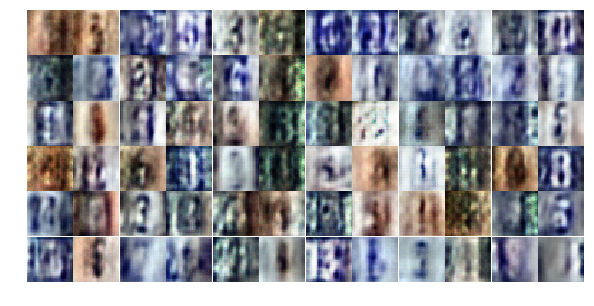

Epoch 3/25... Discriminator Loss: 0.7910... Generator Loss: 1.3252
Epoch 3/25... Discriminator Loss: 0.6814... Generator Loss: 1.2639
Epoch 3/25... Discriminator Loss: 0.7884... Generator Loss: 1.0885
Epoch 3/25... Discriminator Loss: 0.6527... Generator Loss: 1.5415
Epoch 3/25... Discriminator Loss: 0.7754... Generator Loss: 1.0880
Epoch 3/25... Discriminator Loss: 0.8150... Generator Loss: 1.2399
Epoch 3/25... Discriminator Loss: 0.5807... Generator Loss: 1.6028
Epoch 3/25... Discriminator Loss: 0.6208... Generator Loss: 1.5329
Epoch 3/25... Discriminator Loss: 0.5809... Generator Loss: 1.6264
Epoch 3/25... Discriminator Loss: 0.6940... Generator Loss: 1.1538


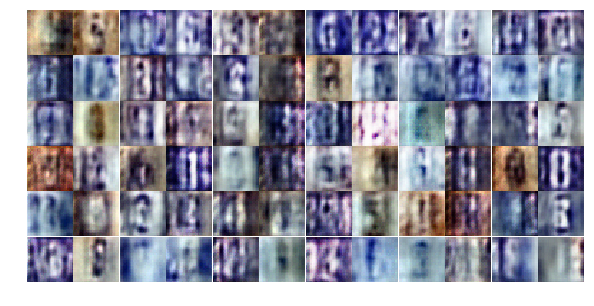

Epoch 3/25... Discriminator Loss: 0.5480... Generator Loss: 1.9649
Epoch 3/25... Discriminator Loss: 0.6652... Generator Loss: 1.1654
Epoch 3/25... Discriminator Loss: 0.6655... Generator Loss: 1.1450
Epoch 3/25... Discriminator Loss: 0.5705... Generator Loss: 1.0841
Epoch 3/25... Discriminator Loss: 0.4710... Generator Loss: 1.5902
Epoch 3/25... Discriminator Loss: 0.7712... Generator Loss: 0.9007
Epoch 3/25... Discriminator Loss: 0.4798... Generator Loss: 2.2138
Epoch 3/25... Discriminator Loss: 0.9035... Generator Loss: 0.8201
Epoch 3/25... Discriminator Loss: 0.6492... Generator Loss: 1.2109
Epoch 3/25... Discriminator Loss: 0.7062... Generator Loss: 1.3426


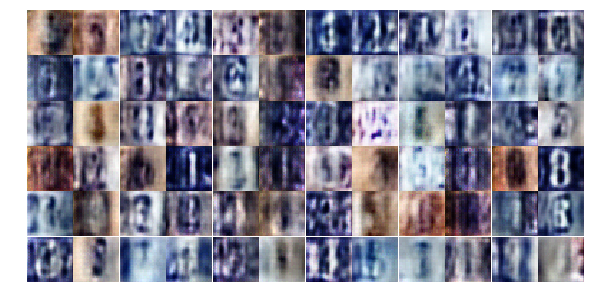

Epoch 3/25... Discriminator Loss: 1.2785... Generator Loss: 1.8830
Epoch 3/25... Discriminator Loss: 0.3578... Generator Loss: 1.9006
Epoch 3/25... Discriminator Loss: 0.7997... Generator Loss: 1.0739
Epoch 3/25... Discriminator Loss: 0.9268... Generator Loss: 0.7295
Epoch 3/25... Discriminator Loss: 0.6617... Generator Loss: 1.5193
Epoch 3/25... Discriminator Loss: 0.5839... Generator Loss: 1.3569
Epoch 3/25... Discriminator Loss: 0.8106... Generator Loss: 1.3142
Epoch 3/25... Discriminator Loss: 0.6472... Generator Loss: 1.0842
Epoch 3/25... Discriminator Loss: 0.8230... Generator Loss: 0.8346
Epoch 3/25... Discriminator Loss: 1.1587... Generator Loss: 0.5799


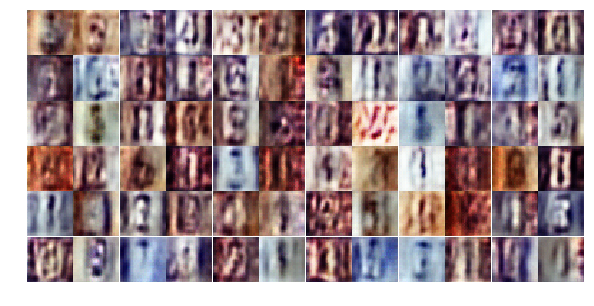

Epoch 3/25... Discriminator Loss: 1.4375... Generator Loss: 2.4082
Epoch 3/25... Discriminator Loss: 0.7874... Generator Loss: 1.3516
Epoch 3/25... Discriminator Loss: 1.1799... Generator Loss: 1.8053
Epoch 3/25... Discriminator Loss: 0.5534... Generator Loss: 1.4766
Epoch 3/25... Discriminator Loss: 0.6494... Generator Loss: 2.3074
Epoch 3/25... Discriminator Loss: 0.5653... Generator Loss: 1.6269
Epoch 3/25... Discriminator Loss: 0.9527... Generator Loss: 2.7447
Epoch 3/25... Discriminator Loss: 0.5612... Generator Loss: 2.0178
Epoch 3/25... Discriminator Loss: 0.5764... Generator Loss: 1.5629
Epoch 3/25... Discriminator Loss: 0.5742... Generator Loss: 2.2513


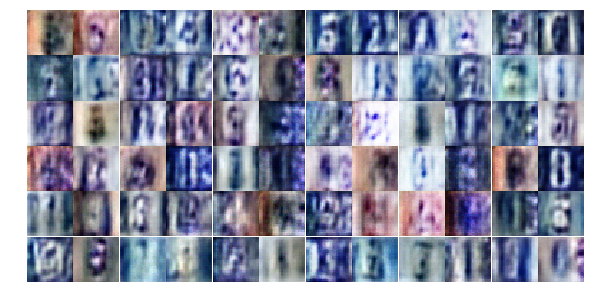

Epoch 3/25... Discriminator Loss: 0.7861... Generator Loss: 0.9974
Epoch 4/25... Discriminator Loss: 0.7539... Generator Loss: 1.0965
Epoch 4/25... Discriminator Loss: 0.7939... Generator Loss: 0.8554
Epoch 4/25... Discriminator Loss: 0.8006... Generator Loss: 0.9189
Epoch 4/25... Discriminator Loss: 0.4957... Generator Loss: 1.4165
Epoch 4/25... Discriminator Loss: 0.5474... Generator Loss: 1.3294
Epoch 4/25... Discriminator Loss: 0.7309... Generator Loss: 1.0159
Epoch 4/25... Discriminator Loss: 0.6322... Generator Loss: 1.2141
Epoch 4/25... Discriminator Loss: 0.5239... Generator Loss: 1.4060
Epoch 4/25... Discriminator Loss: 0.9877... Generator Loss: 0.6372


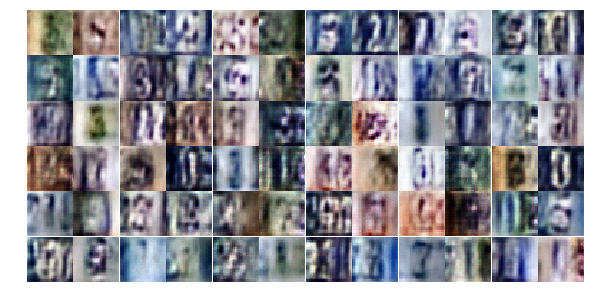

Epoch 4/25... Discriminator Loss: 0.8210... Generator Loss: 1.7483
Epoch 4/25... Discriminator Loss: 0.5104... Generator Loss: 1.3547
Epoch 4/25... Discriminator Loss: 0.8397... Generator Loss: 0.8436
Epoch 4/25... Discriminator Loss: 0.5794... Generator Loss: 1.7101
Epoch 4/25... Discriminator Loss: 0.9865... Generator Loss: 3.1553
Epoch 4/25... Discriminator Loss: 1.1723... Generator Loss: 0.5484
Epoch 4/25... Discriminator Loss: 1.0231... Generator Loss: 0.6049
Epoch 4/25... Discriminator Loss: 0.6812... Generator Loss: 1.5266
Epoch 4/25... Discriminator Loss: 0.4671... Generator Loss: 1.6728
Epoch 4/25... Discriminator Loss: 0.4980... Generator Loss: 2.3670


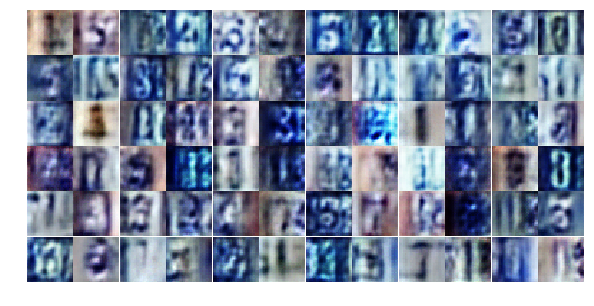

Epoch 4/25... Discriminator Loss: 0.6847... Generator Loss: 1.1937
Epoch 4/25... Discriminator Loss: 0.5238... Generator Loss: 2.1997
Epoch 4/25... Discriminator Loss: 0.4494... Generator Loss: 1.7500
Epoch 4/25... Discriminator Loss: 0.4736... Generator Loss: 1.5108
Epoch 4/25... Discriminator Loss: 0.4321... Generator Loss: 1.8765
Epoch 4/25... Discriminator Loss: 0.6807... Generator Loss: 3.2315
Epoch 4/25... Discriminator Loss: 0.8886... Generator Loss: 0.7548
Epoch 4/25... Discriminator Loss: 0.8845... Generator Loss: 0.7550
Epoch 4/25... Discriminator Loss: 0.6253... Generator Loss: 2.0405
Epoch 4/25... Discriminator Loss: 0.5098... Generator Loss: 1.4209


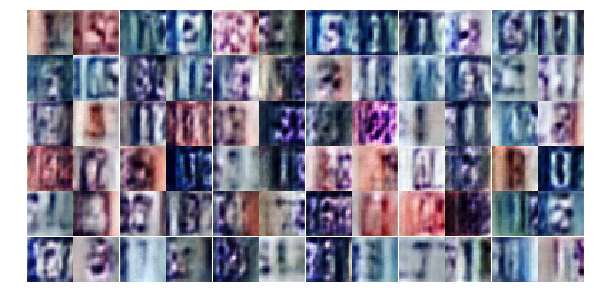

Epoch 4/25... Discriminator Loss: 0.4389... Generator Loss: 2.0210
Epoch 4/25... Discriminator Loss: 0.7235... Generator Loss: 2.2058
Epoch 4/25... Discriminator Loss: 0.3262... Generator Loss: 2.1047
Epoch 4/25... Discriminator Loss: 0.4011... Generator Loss: 2.0086
Epoch 4/25... Discriminator Loss: 0.3693... Generator Loss: 1.6057
Epoch 4/25... Discriminator Loss: 0.4321... Generator Loss: 1.7806
Epoch 4/25... Discriminator Loss: 0.5572... Generator Loss: 2.1802
Epoch 4/25... Discriminator Loss: 1.3162... Generator Loss: 0.4358
Epoch 4/25... Discriminator Loss: 0.4812... Generator Loss: 1.4446
Epoch 4/25... Discriminator Loss: 0.6378... Generator Loss: 1.7732


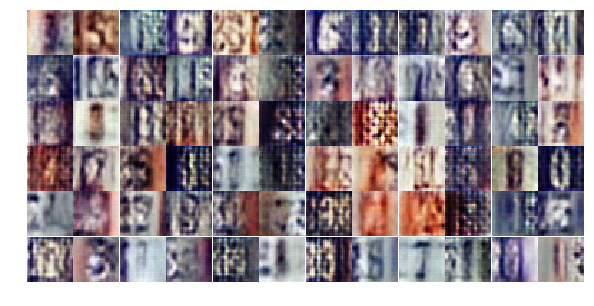

Epoch 4/25... Discriminator Loss: 0.4454... Generator Loss: 1.6896
Epoch 4/25... Discriminator Loss: 0.5139... Generator Loss: 1.5215
Epoch 4/25... Discriminator Loss: 0.5352... Generator Loss: 2.4416
Epoch 4/25... Discriminator Loss: 0.3351... Generator Loss: 2.1652
Epoch 4/25... Discriminator Loss: 0.4416... Generator Loss: 1.8987
Epoch 4/25... Discriminator Loss: 1.6979... Generator Loss: 0.5895
Epoch 4/25... Discriminator Loss: 1.0727... Generator Loss: 0.8058
Epoch 4/25... Discriminator Loss: 1.5362... Generator Loss: 3.2840
Epoch 4/25... Discriminator Loss: 0.6672... Generator Loss: 1.0927
Epoch 4/25... Discriminator Loss: 0.6459... Generator Loss: 1.3420


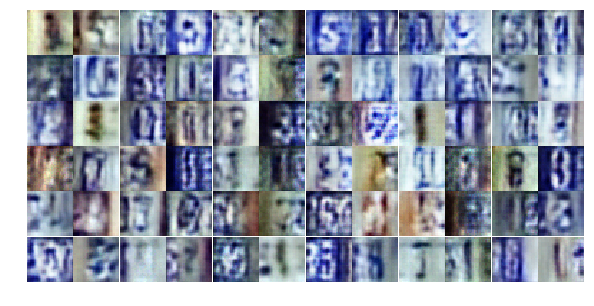

Epoch 4/25... Discriminator Loss: 0.5493... Generator Loss: 1.6605
Epoch 4/25... Discriminator Loss: 0.4596... Generator Loss: 1.6732
Epoch 4/25... Discriminator Loss: 0.2400... Generator Loss: 2.1249
Epoch 4/25... Discriminator Loss: 0.5328... Generator Loss: 1.5805
Epoch 4/25... Discriminator Loss: 0.5929... Generator Loss: 1.3606
Epoch 4/25... Discriminator Loss: 0.7364... Generator Loss: 0.9482
Epoch 4/25... Discriminator Loss: 0.5386... Generator Loss: 1.2714
Epoch 4/25... Discriminator Loss: 0.5746... Generator Loss: 1.4262
Epoch 4/25... Discriminator Loss: 0.6458... Generator Loss: 1.3023
Epoch 5/25... Discriminator Loss: 0.5624... Generator Loss: 1.1411


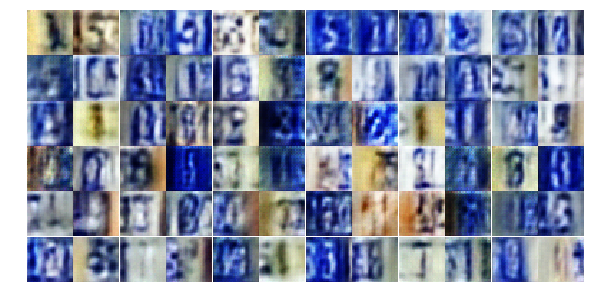

Epoch 5/25... Discriminator Loss: 0.4867... Generator Loss: 1.7868
Epoch 5/25... Discriminator Loss: 1.1936... Generator Loss: 0.4734
Epoch 5/25... Discriminator Loss: 0.6741... Generator Loss: 1.2186
Epoch 5/25... Discriminator Loss: 0.5460... Generator Loss: 1.1125
Epoch 5/25... Discriminator Loss: 0.4801... Generator Loss: 3.2080
Epoch 5/25... Discriminator Loss: 1.9074... Generator Loss: 0.2412
Epoch 5/25... Discriminator Loss: 0.3692... Generator Loss: 1.7886
Epoch 5/25... Discriminator Loss: 0.6655... Generator Loss: 1.2525
Epoch 5/25... Discriminator Loss: 0.5529... Generator Loss: 1.3750
Epoch 5/25... Discriminator Loss: 0.7352... Generator Loss: 0.9437


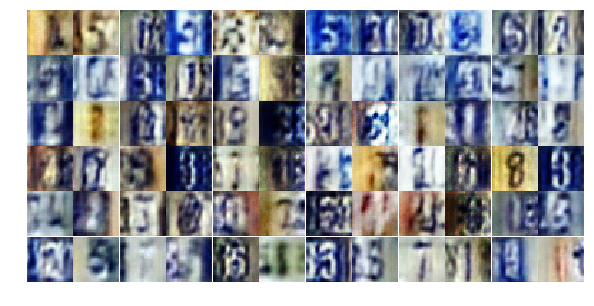

Epoch 5/25... Discriminator Loss: 0.5340... Generator Loss: 1.6001
Epoch 5/25... Discriminator Loss: 0.5905... Generator Loss: 2.7663
Epoch 5/25... Discriminator Loss: 0.5571... Generator Loss: 1.4933
Epoch 5/25... Discriminator Loss: 1.0744... Generator Loss: 0.6833
Epoch 5/25... Discriminator Loss: 0.7437... Generator Loss: 2.7288
Epoch 5/25... Discriminator Loss: 0.8993... Generator Loss: 0.9580
Epoch 5/25... Discriminator Loss: 0.9108... Generator Loss: 0.8837
Epoch 5/25... Discriminator Loss: 0.5742... Generator Loss: 1.2737
Epoch 5/25... Discriminator Loss: 0.5508... Generator Loss: 2.3786
Epoch 5/25... Discriminator Loss: 0.6638... Generator Loss: 1.0398


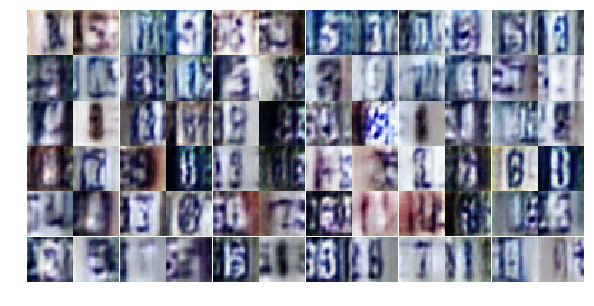

Epoch 5/25... Discriminator Loss: 0.5609... Generator Loss: 1.2997
Epoch 5/25... Discriminator Loss: 0.7881... Generator Loss: 1.0013
Epoch 5/25... Discriminator Loss: 0.4010... Generator Loss: 1.9479
Epoch 5/25... Discriminator Loss: 0.5335... Generator Loss: 1.5403
Epoch 5/25... Discriminator Loss: 0.5621... Generator Loss: 1.2052
Epoch 5/25... Discriminator Loss: 0.7021... Generator Loss: 2.7420
Epoch 5/25... Discriminator Loss: 1.0912... Generator Loss: 0.5844
Epoch 5/25... Discriminator Loss: 0.4589... Generator Loss: 1.8981
Epoch 5/25... Discriminator Loss: 0.5673... Generator Loss: 1.1934
Epoch 5/25... Discriminator Loss: 0.4031... Generator Loss: 1.8130


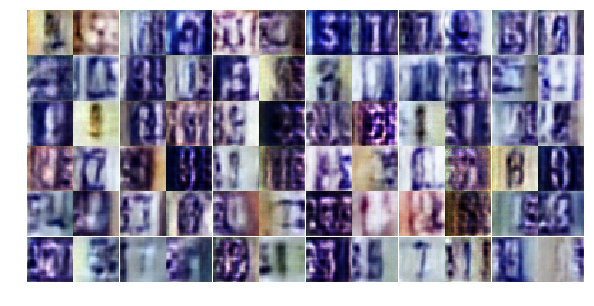

Epoch 5/25... Discriminator Loss: 0.7717... Generator Loss: 0.8954
Epoch 5/25... Discriminator Loss: 0.3967... Generator Loss: 1.5655
Epoch 5/25... Discriminator Loss: 1.1575... Generator Loss: 0.5912
Epoch 5/25... Discriminator Loss: 0.5062... Generator Loss: 1.7487
Epoch 5/25... Discriminator Loss: 0.5815... Generator Loss: 1.4443
Epoch 5/25... Discriminator Loss: 0.6532... Generator Loss: 1.8528
Epoch 5/25... Discriminator Loss: 0.4880... Generator Loss: 1.4780
Epoch 5/25... Discriminator Loss: 0.5697... Generator Loss: 1.1653
Epoch 5/25... Discriminator Loss: 0.7209... Generator Loss: 0.9427
Epoch 5/25... Discriminator Loss: 0.6095... Generator Loss: 1.0917


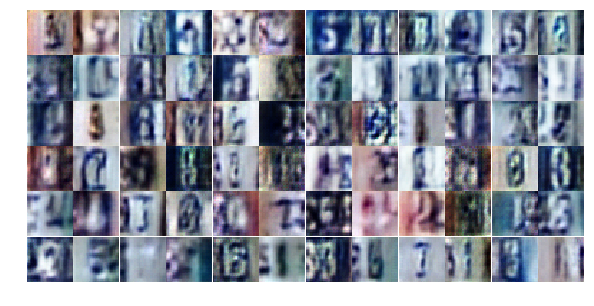

Epoch 5/25... Discriminator Loss: 0.3248... Generator Loss: 2.1358
Epoch 5/25... Discriminator Loss: 0.6594... Generator Loss: 1.0022
Epoch 5/25... Discriminator Loss: 0.8143... Generator Loss: 0.9124
Epoch 5/25... Discriminator Loss: 0.4415... Generator Loss: 1.5070
Epoch 5/25... Discriminator Loss: 2.0629... Generator Loss: 1.5308
Epoch 5/25... Discriminator Loss: 1.1848... Generator Loss: 0.7810
Epoch 5/25... Discriminator Loss: 1.2758... Generator Loss: 2.9173
Epoch 5/25... Discriminator Loss: 1.2662... Generator Loss: 1.1044
Epoch 5/25... Discriminator Loss: 0.9346... Generator Loss: 0.6790
Epoch 5/25... Discriminator Loss: 0.6766... Generator Loss: 1.3735


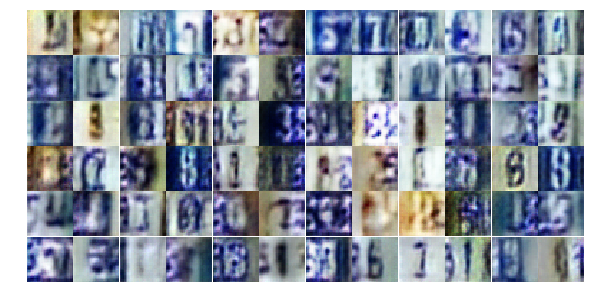

Epoch 5/25... Discriminator Loss: 0.9427... Generator Loss: 0.6998
Epoch 5/25... Discriminator Loss: 0.5330... Generator Loss: 1.4480
Epoch 5/25... Discriminator Loss: 0.9380... Generator Loss: 0.8018
Epoch 5/25... Discriminator Loss: 0.7447... Generator Loss: 0.8734
Epoch 5/25... Discriminator Loss: 0.5100... Generator Loss: 1.5022
Epoch 5/25... Discriminator Loss: 0.7750... Generator Loss: 1.3089
Epoch 6/25... Discriminator Loss: 0.7604... Generator Loss: 0.8505
Epoch 6/25... Discriminator Loss: 0.5709... Generator Loss: 1.3406
Epoch 6/25... Discriminator Loss: 0.5173... Generator Loss: 1.2778
Epoch 6/25... Discriminator Loss: 0.6137... Generator Loss: 1.1406


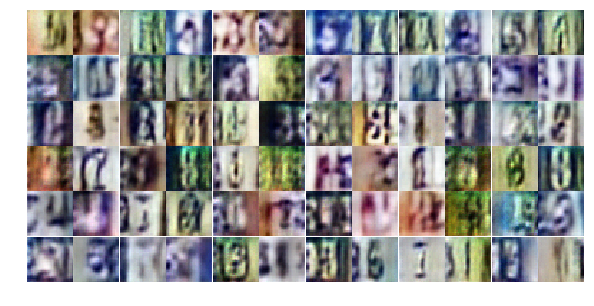

Epoch 6/25... Discriminator Loss: 0.9068... Generator Loss: 0.7517
Epoch 6/25... Discriminator Loss: 0.8415... Generator Loss: 0.9258
Epoch 6/25... Discriminator Loss: 0.5635... Generator Loss: 1.5545
Epoch 6/25... Discriminator Loss: 0.9195... Generator Loss: 0.7879
Epoch 6/25... Discriminator Loss: 0.8897... Generator Loss: 0.7249
Epoch 6/25... Discriminator Loss: 0.8386... Generator Loss: 0.7828
Epoch 6/25... Discriminator Loss: 1.5429... Generator Loss: 0.3482
Epoch 6/25... Discriminator Loss: 0.8291... Generator Loss: 0.8957
Epoch 6/25... Discriminator Loss: 0.5383... Generator Loss: 1.3190
Epoch 6/25... Discriminator Loss: 0.6403... Generator Loss: 1.4299


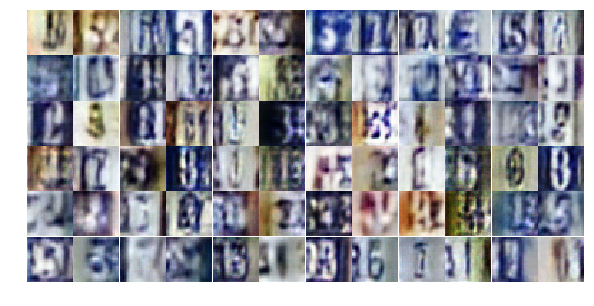

Epoch 6/25... Discriminator Loss: 0.6014... Generator Loss: 1.7417
Epoch 6/25... Discriminator Loss: 1.0056... Generator Loss: 0.7698
Epoch 6/25... Discriminator Loss: 1.0871... Generator Loss: 0.5566
Epoch 6/25... Discriminator Loss: 0.5619... Generator Loss: 1.2115
Epoch 6/25... Discriminator Loss: 0.3667... Generator Loss: 2.1363
Epoch 6/25... Discriminator Loss: 0.5499... Generator Loss: 1.6014
Epoch 6/25... Discriminator Loss: 0.4897... Generator Loss: 1.5180
Epoch 6/25... Discriminator Loss: 0.7350... Generator Loss: 0.9234
Epoch 6/25... Discriminator Loss: 0.6445... Generator Loss: 1.8835
Epoch 6/25... Discriminator Loss: 0.9996... Generator Loss: 0.6900


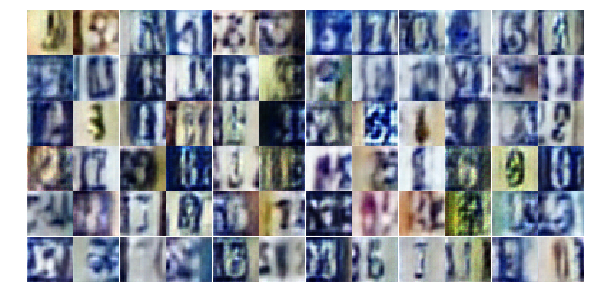

Epoch 6/25... Discriminator Loss: 0.7711... Generator Loss: 0.8470
Epoch 6/25... Discriminator Loss: 1.2841... Generator Loss: 0.5023
Epoch 6/25... Discriminator Loss: 1.1094... Generator Loss: 0.5693
Epoch 6/25... Discriminator Loss: 0.9752... Generator Loss: 0.6547
Epoch 6/25... Discriminator Loss: 0.4626... Generator Loss: 1.6242
Epoch 6/25... Discriminator Loss: 0.8765... Generator Loss: 0.8838
Epoch 6/25... Discriminator Loss: 0.6990... Generator Loss: 2.0055
Epoch 6/25... Discriminator Loss: 0.3990... Generator Loss: 1.4971
Epoch 6/25... Discriminator Loss: 0.3694... Generator Loss: 1.9340
Epoch 6/25... Discriminator Loss: 0.5096... Generator Loss: 1.6340


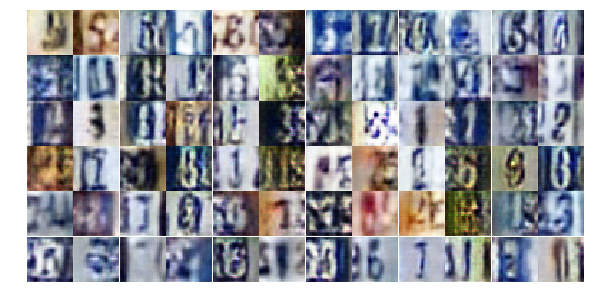

Epoch 6/25... Discriminator Loss: 0.9395... Generator Loss: 2.6683
Epoch 6/25... Discriminator Loss: 0.8635... Generator Loss: 2.6466
Epoch 6/25... Discriminator Loss: 0.7692... Generator Loss: 1.2191
Epoch 6/25... Discriminator Loss: 0.7256... Generator Loss: 0.9633
Epoch 6/25... Discriminator Loss: 0.8309... Generator Loss: 0.8426
Epoch 6/25... Discriminator Loss: 0.7284... Generator Loss: 0.9213
Epoch 6/25... Discriminator Loss: 0.5543... Generator Loss: 1.4956
Epoch 6/25... Discriminator Loss: 0.4860... Generator Loss: 1.3200
Epoch 6/25... Discriminator Loss: 0.6368... Generator Loss: 1.1757
Epoch 6/25... Discriminator Loss: 0.4516... Generator Loss: 1.3447


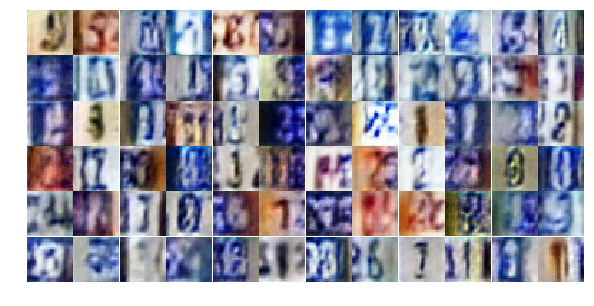

Epoch 6/25... Discriminator Loss: 0.9494... Generator Loss: 0.8000
Epoch 6/25... Discriminator Loss: 0.8194... Generator Loss: 1.9485
Epoch 6/25... Discriminator Loss: 1.4576... Generator Loss: 0.4169
Epoch 6/25... Discriminator Loss: 0.5715... Generator Loss: 1.3108
Epoch 6/25... Discriminator Loss: 0.6441... Generator Loss: 1.3378
Epoch 6/25... Discriminator Loss: 0.5703... Generator Loss: 1.1347
Epoch 6/25... Discriminator Loss: 0.7292... Generator Loss: 1.0439
Epoch 6/25... Discriminator Loss: 1.5780... Generator Loss: 0.3042
Epoch 6/25... Discriminator Loss: 0.7766... Generator Loss: 1.5650
Epoch 6/25... Discriminator Loss: 1.2328... Generator Loss: 0.4882


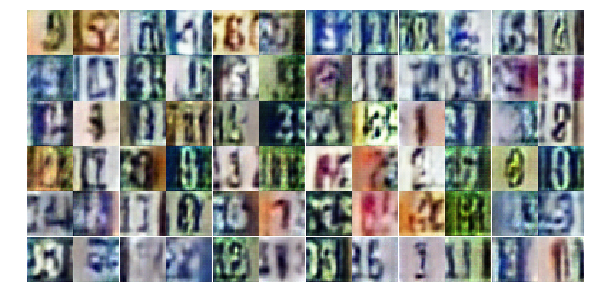

Epoch 6/25... Discriminator Loss: 0.5959... Generator Loss: 1.2037
Epoch 6/25... Discriminator Loss: 0.6640... Generator Loss: 1.0381
Epoch 6/25... Discriminator Loss: 0.5617... Generator Loss: 1.4957
Epoch 7/25... Discriminator Loss: 0.5445... Generator Loss: 1.3669
Epoch 7/25... Discriminator Loss: 0.6579... Generator Loss: 1.1018
Epoch 7/25... Discriminator Loss: 0.6407... Generator Loss: 1.1559
Epoch 7/25... Discriminator Loss: 0.5531... Generator Loss: 1.4561
Epoch 7/25... Discriminator Loss: 0.4771... Generator Loss: 1.4401
Epoch 7/25... Discriminator Loss: 0.4475... Generator Loss: 1.5490
Epoch 7/25... Discriminator Loss: 1.1825... Generator Loss: 0.5037


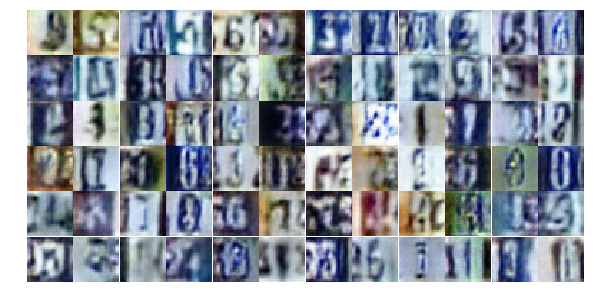

Epoch 7/25... Discriminator Loss: 0.7593... Generator Loss: 2.2392
Epoch 7/25... Discriminator Loss: 0.7340... Generator Loss: 1.1733
Epoch 7/25... Discriminator Loss: 0.8479... Generator Loss: 0.8040
Epoch 7/25... Discriminator Loss: 0.6383... Generator Loss: 1.3168
Epoch 7/25... Discriminator Loss: 0.4825... Generator Loss: 1.4183
Epoch 7/25... Discriminator Loss: 0.4176... Generator Loss: 1.7849
Epoch 7/25... Discriminator Loss: 0.9337... Generator Loss: 2.6614
Epoch 7/25... Discriminator Loss: 1.3960... Generator Loss: 2.9769
Epoch 7/25... Discriminator Loss: 0.5577... Generator Loss: 1.4909
Epoch 7/25... Discriminator Loss: 0.9842... Generator Loss: 0.7045


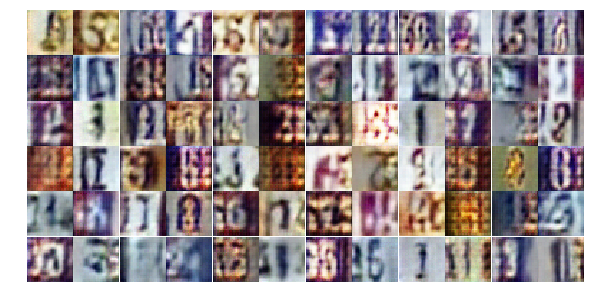

Epoch 7/25... Discriminator Loss: 0.9757... Generator Loss: 0.7328
Epoch 7/25... Discriminator Loss: 0.4656... Generator Loss: 1.4826
Epoch 7/25... Discriminator Loss: 1.0090... Generator Loss: 0.6288
Epoch 7/25... Discriminator Loss: 0.6439... Generator Loss: 1.8594
Epoch 7/25... Discriminator Loss: 0.5491... Generator Loss: 1.1987
Epoch 7/25... Discriminator Loss: 0.5249... Generator Loss: 1.2947
Epoch 7/25... Discriminator Loss: 0.4878... Generator Loss: 1.3392
Epoch 7/25... Discriminator Loss: 1.2690... Generator Loss: 0.4644
Epoch 7/25... Discriminator Loss: 0.4234... Generator Loss: 1.7237
Epoch 7/25... Discriminator Loss: 0.4458... Generator Loss: 2.1586


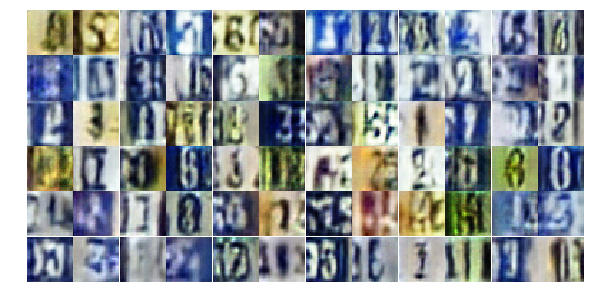

Epoch 7/25... Discriminator Loss: 0.7729... Generator Loss: 0.8164
Epoch 7/25... Discriminator Loss: 2.1257... Generator Loss: 0.2208
Epoch 7/25... Discriminator Loss: 1.0752... Generator Loss: 0.9318
Epoch 7/25... Discriminator Loss: 0.9877... Generator Loss: 0.7314
Epoch 7/25... Discriminator Loss: 0.8923... Generator Loss: 0.6859
Epoch 7/25... Discriminator Loss: 0.8122... Generator Loss: 1.0506
Epoch 7/25... Discriminator Loss: 0.4858... Generator Loss: 1.4909
Epoch 7/25... Discriminator Loss: 0.5898... Generator Loss: 1.4129
Epoch 7/25... Discriminator Loss: 1.4963... Generator Loss: 0.3577
Epoch 7/25... Discriminator Loss: 0.4486... Generator Loss: 2.0949


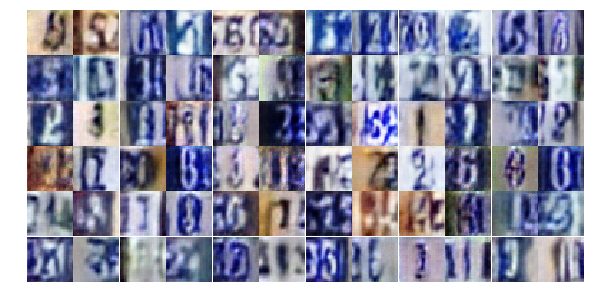

Epoch 7/25... Discriminator Loss: 1.6243... Generator Loss: 0.3021
Epoch 7/25... Discriminator Loss: 0.7999... Generator Loss: 0.9332
Epoch 7/25... Discriminator Loss: 0.3816... Generator Loss: 1.6098
Epoch 7/25... Discriminator Loss: 0.5040... Generator Loss: 1.7499
Epoch 7/25... Discriminator Loss: 0.6668... Generator Loss: 1.0677
Epoch 7/25... Discriminator Loss: 0.5287... Generator Loss: 1.1995
Epoch 7/25... Discriminator Loss: 0.5308... Generator Loss: 1.1888
Epoch 7/25... Discriminator Loss: 1.0085... Generator Loss: 0.6721
Epoch 7/25... Discriminator Loss: 0.5847... Generator Loss: 3.2284
Epoch 7/25... Discriminator Loss: 0.6852... Generator Loss: 1.1072


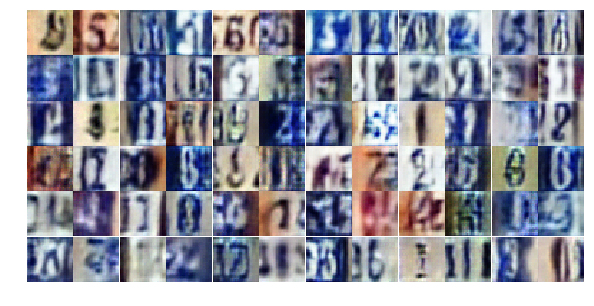

Epoch 7/25... Discriminator Loss: 0.4433... Generator Loss: 1.5437
Epoch 7/25... Discriminator Loss: 0.7801... Generator Loss: 0.8667
Epoch 7/25... Discriminator Loss: 0.8279... Generator Loss: 0.8338
Epoch 7/25... Discriminator Loss: 0.5675... Generator Loss: 1.5841
Epoch 7/25... Discriminator Loss: 0.5425... Generator Loss: 1.1840
Epoch 7/25... Discriminator Loss: 1.0608... Generator Loss: 0.6155
Epoch 7/25... Discriminator Loss: 1.3946... Generator Loss: 0.4125
Epoch 7/25... Discriminator Loss: 0.7413... Generator Loss: 0.9562
Epoch 7/25... Discriminator Loss: 0.6358... Generator Loss: 1.3703
Epoch 7/25... Discriminator Loss: 0.7318... Generator Loss: 0.8858


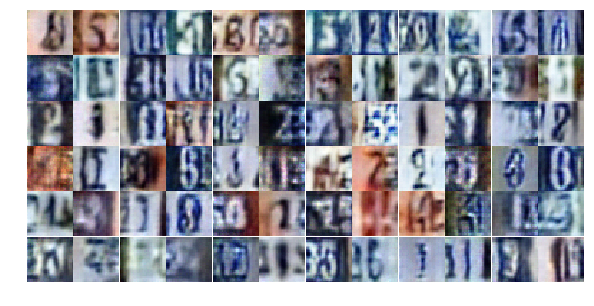

Epoch 7/25... Discriminator Loss: 0.4334... Generator Loss: 1.9290
Epoch 8/25... Discriminator Loss: 0.6233... Generator Loss: 1.1489
Epoch 8/25... Discriminator Loss: 0.8344... Generator Loss: 0.7744
Epoch 8/25... Discriminator Loss: 0.8121... Generator Loss: 0.8455
Epoch 8/25... Discriminator Loss: 0.5355... Generator Loss: 1.3905
Epoch 8/25... Discriminator Loss: 0.7917... Generator Loss: 0.9105
Epoch 8/25... Discriminator Loss: 0.5796... Generator Loss: 1.4768
Epoch 8/25... Discriminator Loss: 0.3760... Generator Loss: 1.5407
Epoch 8/25... Discriminator Loss: 0.8105... Generator Loss: 0.9127
Epoch 8/25... Discriminator Loss: 0.7011... Generator Loss: 0.9190


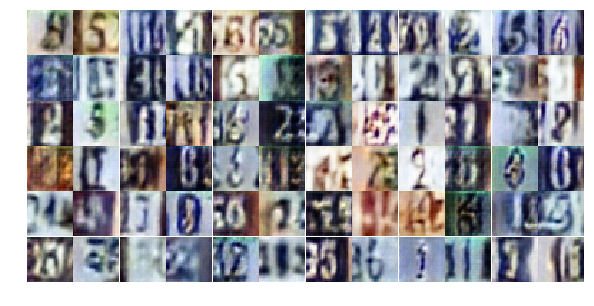

Epoch 8/25... Discriminator Loss: 0.6075... Generator Loss: 1.3462
Epoch 8/25... Discriminator Loss: 0.6312... Generator Loss: 2.0919
Epoch 8/25... Discriminator Loss: 0.6593... Generator Loss: 1.2259
Epoch 8/25... Discriminator Loss: 0.4729... Generator Loss: 1.4805
Epoch 8/25... Discriminator Loss: 1.0302... Generator Loss: 0.5899
Epoch 8/25... Discriminator Loss: 0.6471... Generator Loss: 2.4941
Epoch 8/25... Discriminator Loss: 0.6593... Generator Loss: 1.1463
Epoch 8/25... Discriminator Loss: 1.0850... Generator Loss: 0.6920
Epoch 8/25... Discriminator Loss: 0.8785... Generator Loss: 1.0267
Epoch 8/25... Discriminator Loss: 1.1549... Generator Loss: 0.7135


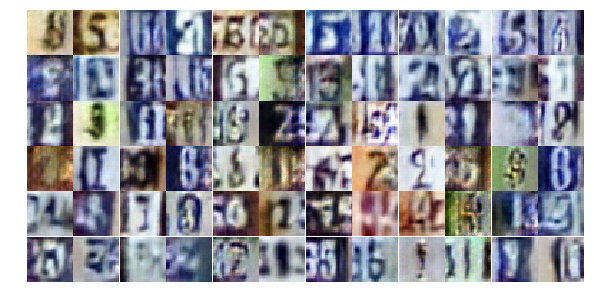

Epoch 8/25... Discriminator Loss: 0.3586... Generator Loss: 1.7371
Epoch 8/25... Discriminator Loss: 0.4384... Generator Loss: 1.4861
Epoch 8/25... Discriminator Loss: 1.0895... Generator Loss: 0.6112
Epoch 8/25... Discriminator Loss: 0.7412... Generator Loss: 1.7446
Epoch 8/25... Discriminator Loss: 0.3432... Generator Loss: 1.8757
Epoch 8/25... Discriminator Loss: 0.5328... Generator Loss: 1.3214
Epoch 8/25... Discriminator Loss: 0.5760... Generator Loss: 2.3443
Epoch 8/25... Discriminator Loss: 0.4218... Generator Loss: 1.4921
Epoch 8/25... Discriminator Loss: 0.5019... Generator Loss: 1.5582
Epoch 8/25... Discriminator Loss: 0.8154... Generator Loss: 0.7877


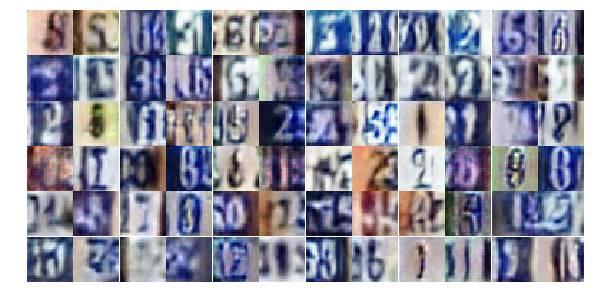

Epoch 8/25... Discriminator Loss: 0.6768... Generator Loss: 1.8292
Epoch 8/25... Discriminator Loss: 0.9298... Generator Loss: 0.6993
Epoch 8/25... Discriminator Loss: 0.6053... Generator Loss: 1.1925
Epoch 8/25... Discriminator Loss: 0.7447... Generator Loss: 0.8657
Epoch 8/25... Discriminator Loss: 1.0420... Generator Loss: 0.6209
Epoch 8/25... Discriminator Loss: 0.3907... Generator Loss: 1.6930
Epoch 8/25... Discriminator Loss: 0.5597... Generator Loss: 1.3246
Epoch 8/25... Discriminator Loss: 0.5304... Generator Loss: 1.4256
Epoch 8/25... Discriminator Loss: 0.7778... Generator Loss: 0.9385
Epoch 8/25... Discriminator Loss: 0.4601... Generator Loss: 1.3507


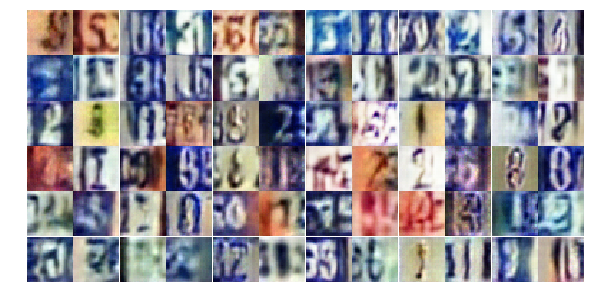

Epoch 8/25... Discriminator Loss: 0.4613... Generator Loss: 1.3604
Epoch 8/25... Discriminator Loss: 1.4508... Generator Loss: 0.4183
Epoch 8/25... Discriminator Loss: 0.7702... Generator Loss: 0.8852
Epoch 8/25... Discriminator Loss: 0.6606... Generator Loss: 1.1323
Epoch 8/25... Discriminator Loss: 0.8781... Generator Loss: 2.5038
Epoch 8/25... Discriminator Loss: 0.9155... Generator Loss: 0.7059
Epoch 8/25... Discriminator Loss: 0.3826... Generator Loss: 2.1912
Epoch 8/25... Discriminator Loss: 0.4587... Generator Loss: 1.9058
Epoch 8/25... Discriminator Loss: 0.7787... Generator Loss: 0.8224
Epoch 8/25... Discriminator Loss: 0.6301... Generator Loss: 1.1184


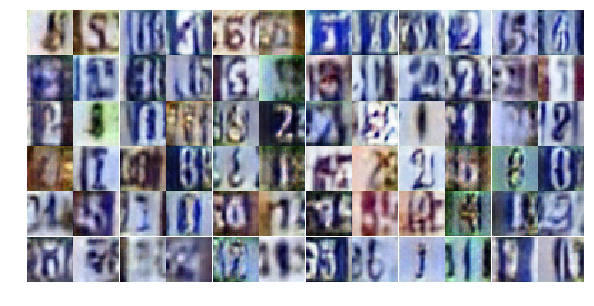

Epoch 8/25... Discriminator Loss: 0.4264... Generator Loss: 2.1618
Epoch 8/25... Discriminator Loss: 0.4918... Generator Loss: 1.3332
Epoch 8/25... Discriminator Loss: 0.9895... Generator Loss: 2.7911
Epoch 8/25... Discriminator Loss: 1.4553... Generator Loss: 0.4119
Epoch 8/25... Discriminator Loss: 0.4339... Generator Loss: 2.1580
Epoch 8/25... Discriminator Loss: 0.9202... Generator Loss: 0.7546
Epoch 8/25... Discriminator Loss: 0.5970... Generator Loss: 1.1375
Epoch 8/25... Discriminator Loss: 0.5329... Generator Loss: 1.6318
Epoch 9/25... Discriminator Loss: 0.7714... Generator Loss: 2.1164
Epoch 9/25... Discriminator Loss: 0.6775... Generator Loss: 1.0598


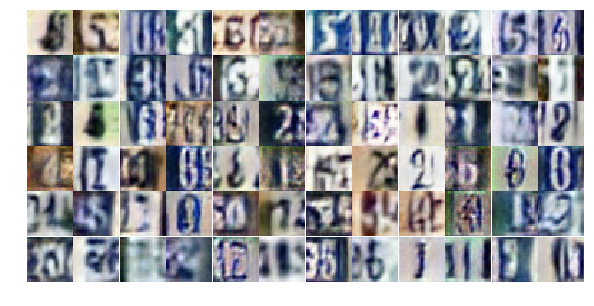

Epoch 9/25... Discriminator Loss: 0.5663... Generator Loss: 1.5562
Epoch 9/25... Discriminator Loss: 0.8013... Generator Loss: 0.9871
Epoch 9/25... Discriminator Loss: 0.9726... Generator Loss: 0.6589
Epoch 9/25... Discriminator Loss: 0.4534... Generator Loss: 1.4795
Epoch 9/25... Discriminator Loss: 0.9791... Generator Loss: 0.6527
Epoch 9/25... Discriminator Loss: 0.5919... Generator Loss: 2.5406
Epoch 9/25... Discriminator Loss: 0.7799... Generator Loss: 1.0248
Epoch 9/25... Discriminator Loss: 0.5198... Generator Loss: 1.2517
Epoch 9/25... Discriminator Loss: 0.7421... Generator Loss: 0.9259
Epoch 9/25... Discriminator Loss: 0.5402... Generator Loss: 1.4445


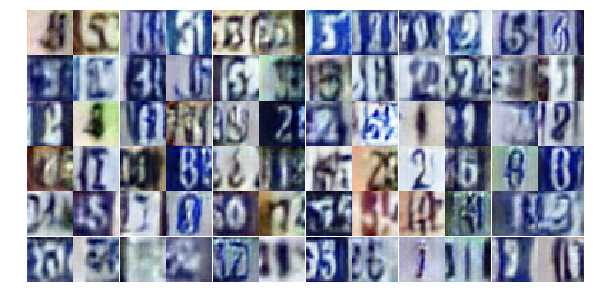

Epoch 9/25... Discriminator Loss: 0.9619... Generator Loss: 0.6837
Epoch 9/25... Discriminator Loss: 0.9382... Generator Loss: 0.6912
Epoch 9/25... Discriminator Loss: 1.5727... Generator Loss: 0.3500
Epoch 9/25... Discriminator Loss: 1.1484... Generator Loss: 0.5976
Epoch 9/25... Discriminator Loss: 0.5551... Generator Loss: 1.2239
Epoch 9/25... Discriminator Loss: 0.7306... Generator Loss: 1.3717
Epoch 9/25... Discriminator Loss: 0.8888... Generator Loss: 0.7359
Epoch 9/25... Discriminator Loss: 0.4660... Generator Loss: 1.4416
Epoch 9/25... Discriminator Loss: 0.6937... Generator Loss: 0.9580
Epoch 9/25... Discriminator Loss: 0.8997... Generator Loss: 0.7665


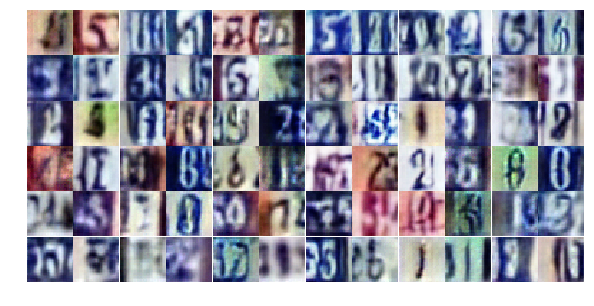

Epoch 9/25... Discriminator Loss: 0.7158... Generator Loss: 0.9490
Epoch 9/25... Discriminator Loss: 0.9745... Generator Loss: 0.6091
Epoch 9/25... Discriminator Loss: 0.8990... Generator Loss: 2.1271
Epoch 9/25... Discriminator Loss: 0.6093... Generator Loss: 1.1465
Epoch 9/25... Discriminator Loss: 0.5189... Generator Loss: 1.8069
Epoch 9/25... Discriminator Loss: 0.4393... Generator Loss: 1.7148
Epoch 9/25... Discriminator Loss: 1.5093... Generator Loss: 0.3543
Epoch 9/25... Discriminator Loss: 0.4951... Generator Loss: 1.7810
Epoch 9/25... Discriminator Loss: 0.6958... Generator Loss: 0.9994
Epoch 9/25... Discriminator Loss: 0.5971... Generator Loss: 1.0998


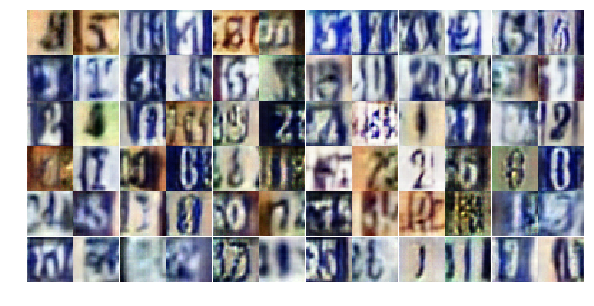

Epoch 9/25... Discriminator Loss: 0.5741... Generator Loss: 1.1817
Epoch 9/25... Discriminator Loss: 0.5800... Generator Loss: 1.1248
Epoch 9/25... Discriminator Loss: 0.8688... Generator Loss: 0.7627
Epoch 9/25... Discriminator Loss: 0.5089... Generator Loss: 2.2730
Epoch 9/25... Discriminator Loss: 0.7010... Generator Loss: 0.9601
Epoch 9/25... Discriminator Loss: 0.7625... Generator Loss: 1.8253
Epoch 9/25... Discriminator Loss: 0.4503... Generator Loss: 1.7643
Epoch 9/25... Discriminator Loss: 0.4037... Generator Loss: 1.4323
Epoch 9/25... Discriminator Loss: 0.9186... Generator Loss: 0.7044
Epoch 9/25... Discriminator Loss: 0.6827... Generator Loss: 1.0754


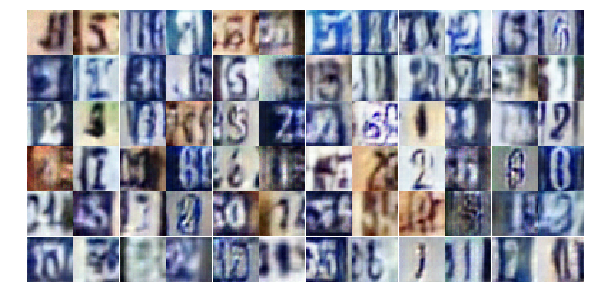

Epoch 9/25... Discriminator Loss: 0.6111... Generator Loss: 1.2900
Epoch 9/25... Discriminator Loss: 0.4402... Generator Loss: 1.7315
Epoch 9/25... Discriminator Loss: 0.4469... Generator Loss: 1.6311
Epoch 9/25... Discriminator Loss: 0.7106... Generator Loss: 1.1079
Epoch 9/25... Discriminator Loss: 0.4022... Generator Loss: 2.3934
Epoch 9/25... Discriminator Loss: 0.6354... Generator Loss: 1.0910
Epoch 9/25... Discriminator Loss: 0.7501... Generator Loss: 1.1565
Epoch 9/25... Discriminator Loss: 1.1700... Generator Loss: 0.5012
Epoch 9/25... Discriminator Loss: 0.5116... Generator Loss: 1.3479
Epoch 9/25... Discriminator Loss: 0.5430... Generator Loss: 1.6149


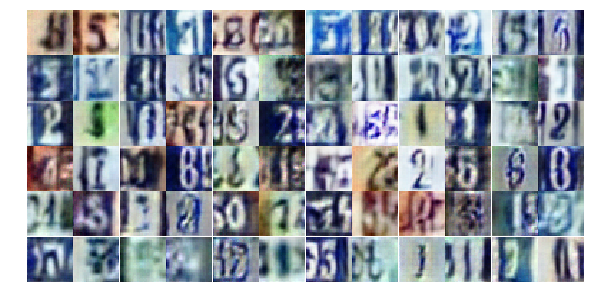

Epoch 9/25... Discriminator Loss: 1.4083... Generator Loss: 0.4195
Epoch 9/25... Discriminator Loss: 0.6710... Generator Loss: 1.7184
Epoch 9/25... Discriminator Loss: 0.5877... Generator Loss: 1.3472
Epoch 9/25... Discriminator Loss: 1.6755... Generator Loss: 0.2785
Epoch 9/25... Discriminator Loss: 0.6889... Generator Loss: 0.9844
Epoch 10/25... Discriminator Loss: 0.6009... Generator Loss: 1.2859
Epoch 10/25... Discriminator Loss: 0.5162... Generator Loss: 1.3887
Epoch 10/25... Discriminator Loss: 0.7840... Generator Loss: 0.8469
Epoch 10/25... Discriminator Loss: 0.7694... Generator Loss: 0.8853
Epoch 10/25... Discriminator Loss: 0.9824... Generator Loss: 0.6050


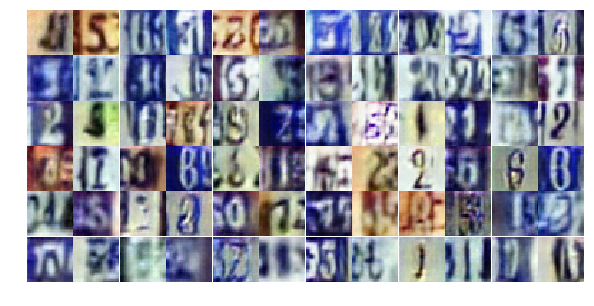

Epoch 10/25... Discriminator Loss: 1.1748... Generator Loss: 0.5730
Epoch 10/25... Discriminator Loss: 0.7653... Generator Loss: 1.0709
Epoch 10/25... Discriminator Loss: 0.5560... Generator Loss: 1.2612
Epoch 10/25... Discriminator Loss: 0.6033... Generator Loss: 1.7278
Epoch 10/25... Discriminator Loss: 0.5352... Generator Loss: 1.4562
Epoch 10/25... Discriminator Loss: 0.5866... Generator Loss: 1.4991
Epoch 10/25... Discriminator Loss: 0.5334... Generator Loss: 1.1990
Epoch 10/25... Discriminator Loss: 0.8403... Generator Loss: 0.7511
Epoch 10/25... Discriminator Loss: 0.7380... Generator Loss: 0.9489
Epoch 10/25... Discriminator Loss: 0.5062... Generator Loss: 1.4044


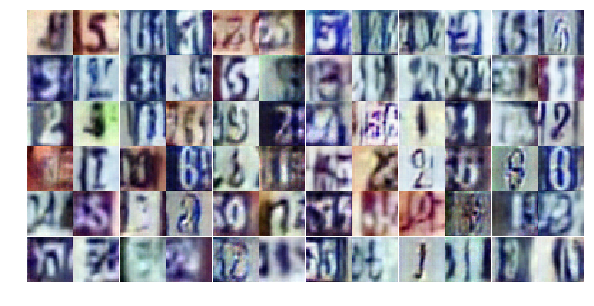

Epoch 10/25... Discriminator Loss: 0.7077... Generator Loss: 1.1040
Epoch 10/25... Discriminator Loss: 0.6840... Generator Loss: 1.1357
Epoch 10/25... Discriminator Loss: 0.9693... Generator Loss: 0.9132
Epoch 10/25... Discriminator Loss: 0.7793... Generator Loss: 0.9284
Epoch 10/25... Discriminator Loss: 0.6235... Generator Loss: 1.1625
Epoch 10/25... Discriminator Loss: 0.3758... Generator Loss: 1.6896
Epoch 10/25... Discriminator Loss: 0.5591... Generator Loss: 1.3172
Epoch 10/25... Discriminator Loss: 0.5416... Generator Loss: 1.1913
Epoch 10/25... Discriminator Loss: 0.6619... Generator Loss: 1.1204
Epoch 10/25... Discriminator Loss: 0.2703... Generator Loss: 2.1257


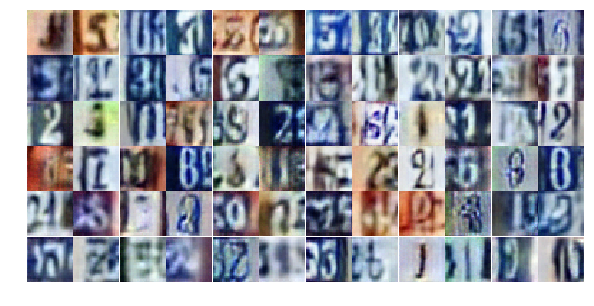

Epoch 10/25... Discriminator Loss: 1.0929... Generator Loss: 0.5352
Epoch 10/25... Discriminator Loss: 0.9485... Generator Loss: 0.7073
Epoch 10/25... Discriminator Loss: 0.3795... Generator Loss: 1.7065
Epoch 10/25... Discriminator Loss: 0.4383... Generator Loss: 1.3309
Epoch 10/25... Discriminator Loss: 1.1547... Generator Loss: 0.5616
Epoch 10/25... Discriminator Loss: 0.5243... Generator Loss: 1.4398
Epoch 10/25... Discriminator Loss: 0.4415... Generator Loss: 1.2907
Epoch 10/25... Discriminator Loss: 0.8042... Generator Loss: 0.9311
Epoch 10/25... Discriminator Loss: 0.5344... Generator Loss: 1.2845
Epoch 10/25... Discriminator Loss: 1.4634... Generator Loss: 0.3482


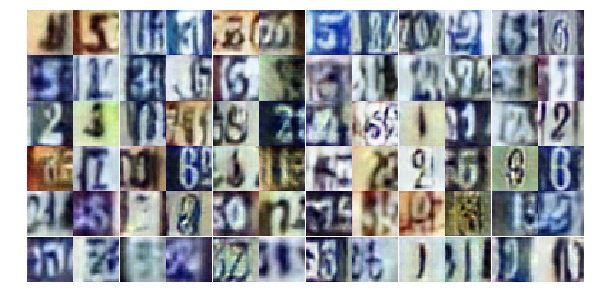

Epoch 10/25... Discriminator Loss: 0.6185... Generator Loss: 1.8736
Epoch 10/25... Discriminator Loss: 0.8391... Generator Loss: 0.8346
Epoch 10/25... Discriminator Loss: 0.5330... Generator Loss: 1.4759
Epoch 10/25... Discriminator Loss: 0.7113... Generator Loss: 1.8384
Epoch 10/25... Discriminator Loss: 0.8969... Generator Loss: 0.7521
Epoch 10/25... Discriminator Loss: 0.9698... Generator Loss: 0.6642
Epoch 10/25... Discriminator Loss: 2.5097... Generator Loss: 0.1454
Epoch 10/25... Discriminator Loss: 1.4150... Generator Loss: 0.3992
Epoch 10/25... Discriminator Loss: 0.8782... Generator Loss: 0.7781
Epoch 10/25... Discriminator Loss: 0.8690... Generator Loss: 1.8267


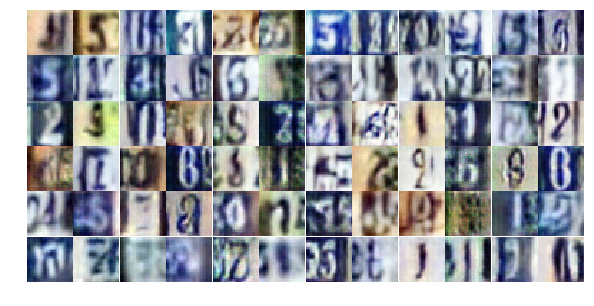

Epoch 10/25... Discriminator Loss: 0.4640... Generator Loss: 1.4368
Epoch 10/25... Discriminator Loss: 0.7457... Generator Loss: 1.1404
Epoch 10/25... Discriminator Loss: 0.6562... Generator Loss: 1.0182
Epoch 10/25... Discriminator Loss: 0.7689... Generator Loss: 0.9317
Epoch 10/25... Discriminator Loss: 0.4826... Generator Loss: 1.3491
Epoch 10/25... Discriminator Loss: 0.6868... Generator Loss: 2.1467
Epoch 10/25... Discriminator Loss: 0.7577... Generator Loss: 0.9418
Epoch 10/25... Discriminator Loss: 0.5826... Generator Loss: 1.9154
Epoch 10/25... Discriminator Loss: 1.0013... Generator Loss: 0.8077
Epoch 10/25... Discriminator Loss: 0.6188... Generator Loss: 1.2865


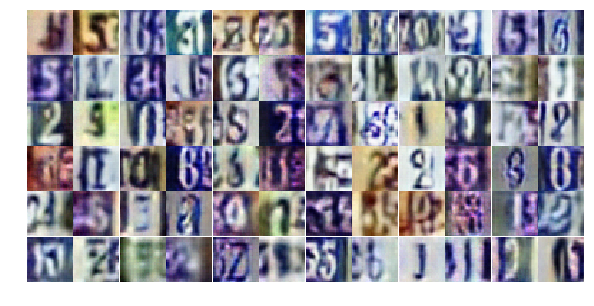

Epoch 10/25... Discriminator Loss: 0.6467... Generator Loss: 2.1161
Epoch 10/25... Discriminator Loss: 0.4131... Generator Loss: 1.6275
Epoch 10/25... Discriminator Loss: 0.4621... Generator Loss: 1.3892
Epoch 11/25... Discriminator Loss: 1.0901... Generator Loss: 0.6085
Epoch 11/25... Discriminator Loss: 0.5780... Generator Loss: 1.2060
Epoch 11/25... Discriminator Loss: 1.1597... Generator Loss: 0.5193
Epoch 11/25... Discriminator Loss: 0.8089... Generator Loss: 0.8043
Epoch 11/25... Discriminator Loss: 0.5430... Generator Loss: 1.3218
Epoch 11/25... Discriminator Loss: 2.0233... Generator Loss: 0.2412
Epoch 11/25... Discriminator Loss: 0.7136... Generator Loss: 1.4656


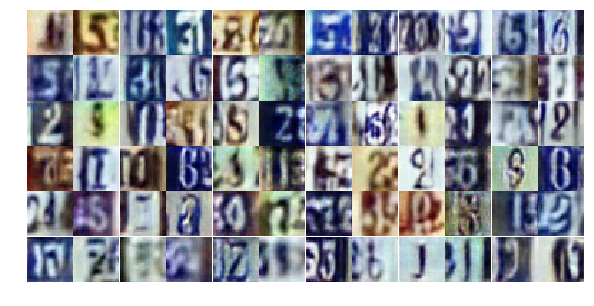

Epoch 11/25... Discriminator Loss: 0.6125... Generator Loss: 1.6962
Epoch 11/25... Discriminator Loss: 0.7200... Generator Loss: 0.8707
Epoch 11/25... Discriminator Loss: 0.4079... Generator Loss: 1.7645
Epoch 11/25... Discriminator Loss: 0.5097... Generator Loss: 1.5195
Epoch 11/25... Discriminator Loss: 0.7117... Generator Loss: 1.0894
Epoch 11/25... Discriminator Loss: 0.4874... Generator Loss: 1.4534
Epoch 11/25... Discriminator Loss: 0.5039... Generator Loss: 1.8448
Epoch 11/25... Discriminator Loss: 0.2593... Generator Loss: 2.2453
Epoch 11/25... Discriminator Loss: 0.6095... Generator Loss: 1.1404
Epoch 11/25... Discriminator Loss: 1.2461... Generator Loss: 0.5159


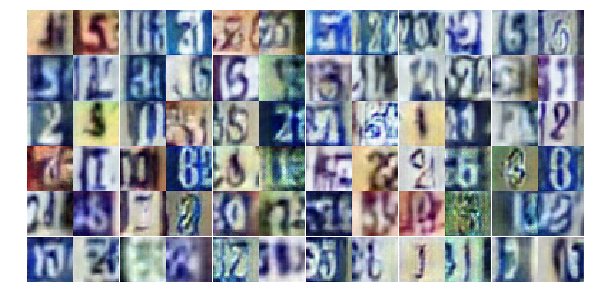

Epoch 11/25... Discriminator Loss: 1.4539... Generator Loss: 0.4417
Epoch 11/25... Discriminator Loss: 0.4468... Generator Loss: 1.6690
Epoch 11/25... Discriminator Loss: 0.7582... Generator Loss: 0.8582
Epoch 11/25... Discriminator Loss: 0.6990... Generator Loss: 0.9648
Epoch 11/25... Discriminator Loss: 0.3037... Generator Loss: 1.9914
Epoch 11/25... Discriminator Loss: 0.4725... Generator Loss: 1.3847
Epoch 11/25... Discriminator Loss: 0.5707... Generator Loss: 1.1386
Epoch 11/25... Discriminator Loss: 0.7580... Generator Loss: 1.4234
Epoch 11/25... Discriminator Loss: 0.4610... Generator Loss: 1.4441
Epoch 11/25... Discriminator Loss: 0.7226... Generator Loss: 0.9086


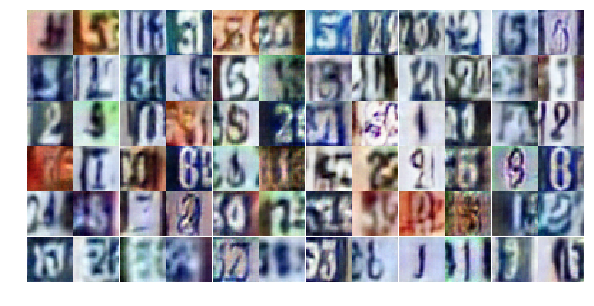

Epoch 11/25... Discriminator Loss: 0.8799... Generator Loss: 0.8764
Epoch 11/25... Discriminator Loss: 0.5710... Generator Loss: 1.2028
Epoch 11/25... Discriminator Loss: 0.7849... Generator Loss: 0.9847
Epoch 11/25... Discriminator Loss: 0.4697... Generator Loss: 1.3979
Epoch 11/25... Discriminator Loss: 0.6672... Generator Loss: 1.0301
Epoch 11/25... Discriminator Loss: 0.7966... Generator Loss: 0.9040
Epoch 11/25... Discriminator Loss: 0.7138... Generator Loss: 1.3238
Epoch 11/25... Discriminator Loss: 0.9119... Generator Loss: 0.6941
Epoch 11/25... Discriminator Loss: 0.4914... Generator Loss: 1.4924
Epoch 11/25... Discriminator Loss: 0.8182... Generator Loss: 0.8174


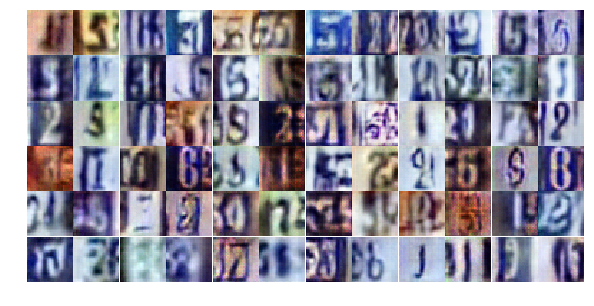

Epoch 11/25... Discriminator Loss: 0.5013... Generator Loss: 1.6856
Epoch 11/25... Discriminator Loss: 0.7457... Generator Loss: 0.9725
Epoch 11/25... Discriminator Loss: 0.5323... Generator Loss: 1.3852
Epoch 11/25... Discriminator Loss: 0.6363... Generator Loss: 1.1521
Epoch 11/25... Discriminator Loss: 1.0339... Generator Loss: 0.6738
Epoch 11/25... Discriminator Loss: 0.5219... Generator Loss: 1.3064
Epoch 11/25... Discriminator Loss: 0.3487... Generator Loss: 2.1324
Epoch 11/25... Discriminator Loss: 0.9163... Generator Loss: 0.6930
Epoch 11/25... Discriminator Loss: 1.6381... Generator Loss: 0.3424
Epoch 11/25... Discriminator Loss: 0.5264... Generator Loss: 1.3038


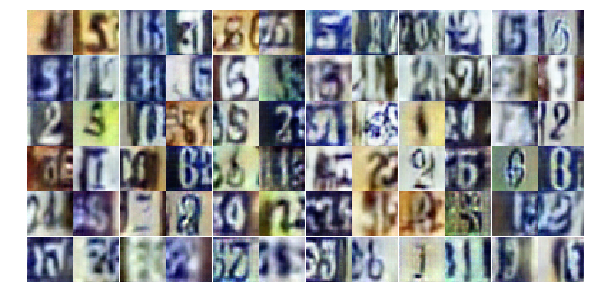

Epoch 11/25... Discriminator Loss: 1.4893... Generator Loss: 0.3759
Epoch 11/25... Discriminator Loss: 0.5973... Generator Loss: 1.2889
Epoch 11/25... Discriminator Loss: 0.7557... Generator Loss: 1.0381
Epoch 11/25... Discriminator Loss: 0.7206... Generator Loss: 0.9327
Epoch 11/25... Discriminator Loss: 1.0681... Generator Loss: 0.6729
Epoch 11/25... Discriminator Loss: 0.6902... Generator Loss: 0.9883
Epoch 11/25... Discriminator Loss: 0.8244... Generator Loss: 0.8838
Epoch 11/25... Discriminator Loss: 0.5300... Generator Loss: 1.8526
Epoch 11/25... Discriminator Loss: 0.9752... Generator Loss: 0.7787
Epoch 11/25... Discriminator Loss: 0.6200... Generator Loss: 1.3439


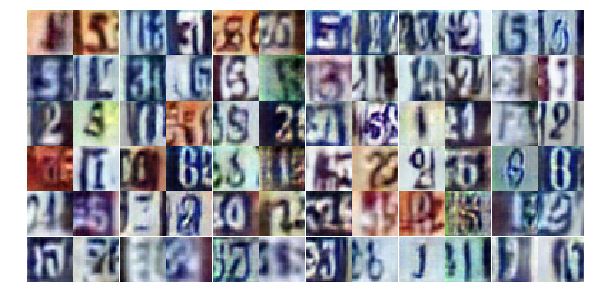

Epoch 12/25... Discriminator Loss: 0.6368... Generator Loss: 1.1821
Epoch 12/25... Discriminator Loss: 0.5703... Generator Loss: 1.5680
Epoch 12/25... Discriminator Loss: 0.7253... Generator Loss: 1.0024
Epoch 12/25... Discriminator Loss: 0.6852... Generator Loss: 1.1467
Epoch 12/25... Discriminator Loss: 0.4475... Generator Loss: 1.8468
Epoch 12/25... Discriminator Loss: 0.5481... Generator Loss: 1.1726
Epoch 12/25... Discriminator Loss: 0.6717... Generator Loss: 1.0312
Epoch 12/25... Discriminator Loss: 0.3973... Generator Loss: 1.6944
Epoch 12/25... Discriminator Loss: 0.5214... Generator Loss: 1.4763
Epoch 12/25... Discriminator Loss: 1.3394... Generator Loss: 0.4268


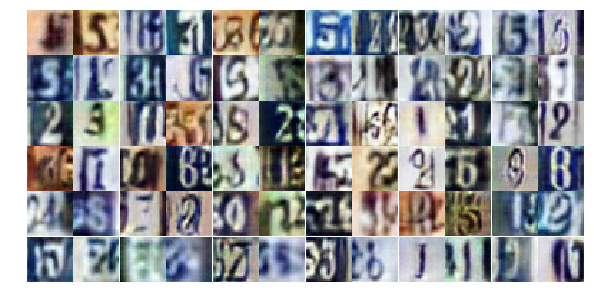

Epoch 12/25... Discriminator Loss: 0.6033... Generator Loss: 1.1228
Epoch 12/25... Discriminator Loss: 0.7292... Generator Loss: 0.9521
Epoch 12/25... Discriminator Loss: 0.6215... Generator Loss: 2.7808
Epoch 12/25... Discriminator Loss: 0.7878... Generator Loss: 1.7956
Epoch 12/25... Discriminator Loss: 0.6675... Generator Loss: 1.1176
Epoch 12/25... Discriminator Loss: 1.0635... Generator Loss: 1.0594
Epoch 12/25... Discriminator Loss: 1.4752... Generator Loss: 0.3761
Epoch 12/25... Discriminator Loss: 0.4632... Generator Loss: 1.4781
Epoch 12/25... Discriminator Loss: 0.6942... Generator Loss: 0.9461
Epoch 12/25... Discriminator Loss: 0.7037... Generator Loss: 0.9626


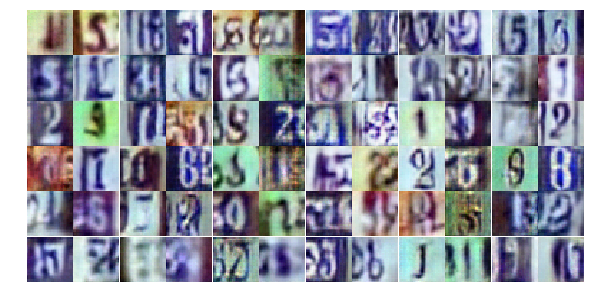

Epoch 12/25... Discriminator Loss: 0.3915... Generator Loss: 1.4769
Epoch 12/25... Discriminator Loss: 0.4280... Generator Loss: 1.7802
Epoch 12/25... Discriminator Loss: 0.8137... Generator Loss: 0.9156
Epoch 12/25... Discriminator Loss: 0.5921... Generator Loss: 1.0835
Epoch 12/25... Discriminator Loss: 0.4105... Generator Loss: 1.7209
Epoch 12/25... Discriminator Loss: 0.5896... Generator Loss: 1.3814
Epoch 12/25... Discriminator Loss: 0.9516... Generator Loss: 0.6495
Epoch 12/25... Discriminator Loss: 0.4237... Generator Loss: 1.8482
Epoch 12/25... Discriminator Loss: 0.5637... Generator Loss: 1.1425
Epoch 12/25... Discriminator Loss: 0.5531... Generator Loss: 1.2609


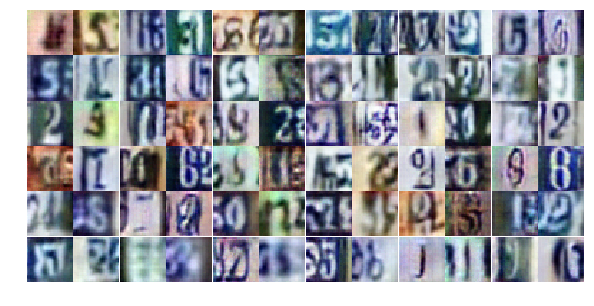

Epoch 12/25... Discriminator Loss: 0.6933... Generator Loss: 0.9802
Epoch 12/25... Discriminator Loss: 0.8814... Generator Loss: 0.7673
Epoch 12/25... Discriminator Loss: 0.9742... Generator Loss: 0.6804
Epoch 12/25... Discriminator Loss: 1.6689... Generator Loss: 0.2979
Epoch 12/25... Discriminator Loss: 3.5453... Generator Loss: 5.3566
Epoch 12/25... Discriminator Loss: 1.0930... Generator Loss: 0.9894
Epoch 12/25... Discriminator Loss: 1.2003... Generator Loss: 0.5013
Epoch 12/25... Discriminator Loss: 1.0332... Generator Loss: 0.6878
Epoch 12/25... Discriminator Loss: 0.5567... Generator Loss: 1.3885
Epoch 12/25... Discriminator Loss: 0.4005... Generator Loss: 1.6896


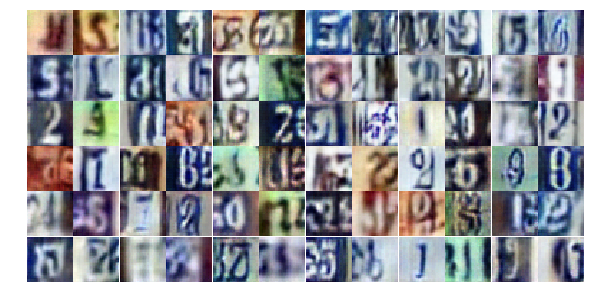

Epoch 12/25... Discriminator Loss: 0.7798... Generator Loss: 0.8585
Epoch 12/25... Discriminator Loss: 0.4267... Generator Loss: 1.3633
Epoch 12/25... Discriminator Loss: 0.4673... Generator Loss: 1.3186
Epoch 12/25... Discriminator Loss: 0.7361... Generator Loss: 0.9901
Epoch 12/25... Discriminator Loss: 0.5632... Generator Loss: 1.7687
Epoch 12/25... Discriminator Loss: 0.9471... Generator Loss: 0.6679
Epoch 12/25... Discriminator Loss: 0.7182... Generator Loss: 0.9953
Epoch 12/25... Discriminator Loss: 0.8394... Generator Loss: 0.8141
Epoch 12/25... Discriminator Loss: 0.6236... Generator Loss: 1.0908
Epoch 12/25... Discriminator Loss: 0.7210... Generator Loss: 0.9954


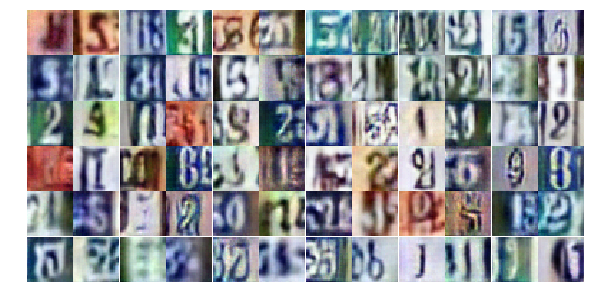

Epoch 12/25... Discriminator Loss: 1.0255... Generator Loss: 0.7652
Epoch 12/25... Discriminator Loss: 1.1355... Generator Loss: 0.6277
Epoch 12/25... Discriminator Loss: 0.6841... Generator Loss: 1.0378
Epoch 12/25... Discriminator Loss: 1.2711... Generator Loss: 0.4385
Epoch 12/25... Discriminator Loss: 0.6270... Generator Loss: 1.0318
Epoch 12/25... Discriminator Loss: 0.9946... Generator Loss: 3.5750
Epoch 12/25... Discriminator Loss: 0.8226... Generator Loss: 1.5042
Epoch 13/25... Discriminator Loss: 0.5789... Generator Loss: 1.2964
Epoch 13/25... Discriminator Loss: 0.4330... Generator Loss: 1.6914
Epoch 13/25... Discriminator Loss: 0.7771... Generator Loss: 0.8991


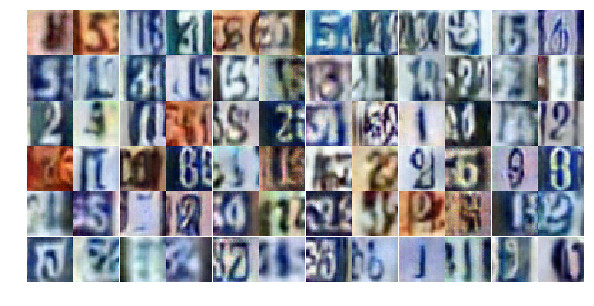

Epoch 13/25... Discriminator Loss: 0.6912... Generator Loss: 0.9912
Epoch 13/25... Discriminator Loss: 0.5481... Generator Loss: 1.2688
Epoch 13/25... Discriminator Loss: 1.3267... Generator Loss: 0.4755
Epoch 13/25... Discriminator Loss: 1.1289... Generator Loss: 0.5312
Epoch 13/25... Discriminator Loss: 0.6257... Generator Loss: 1.1247
Epoch 13/25... Discriminator Loss: 0.5579... Generator Loss: 1.2557
Epoch 13/25... Discriminator Loss: 0.4364... Generator Loss: 1.5999
Epoch 13/25... Discriminator Loss: 0.5371... Generator Loss: 1.1638
Epoch 13/25... Discriminator Loss: 0.4200... Generator Loss: 1.4515
Epoch 13/25... Discriminator Loss: 0.5708... Generator Loss: 1.3546


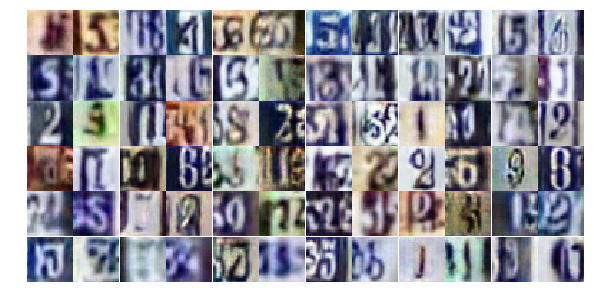

Epoch 13/25... Discriminator Loss: 1.0040... Generator Loss: 0.9689
Epoch 13/25... Discriminator Loss: 0.5822... Generator Loss: 1.0837
Epoch 13/25... Discriminator Loss: 1.6339... Generator Loss: 0.3036
Epoch 13/25... Discriminator Loss: 0.8023... Generator Loss: 0.9598
Epoch 13/25... Discriminator Loss: 0.9214... Generator Loss: 1.1989
Epoch 13/25... Discriminator Loss: 1.5328... Generator Loss: 0.3978
Epoch 13/25... Discriminator Loss: 0.9573... Generator Loss: 0.7650
Epoch 13/25... Discriminator Loss: 1.1712... Generator Loss: 0.5701
Epoch 13/25... Discriminator Loss: 0.5449... Generator Loss: 1.1953
Epoch 13/25... Discriminator Loss: 0.9118... Generator Loss: 0.6610


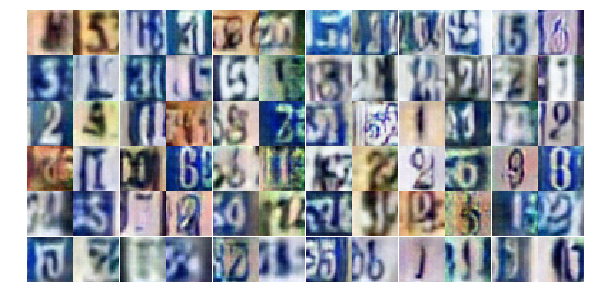

Epoch 13/25... Discriminator Loss: 0.7655... Generator Loss: 0.9489
Epoch 13/25... Discriminator Loss: 0.5228... Generator Loss: 1.5973
Epoch 13/25... Discriminator Loss: 0.5900... Generator Loss: 1.8449
Epoch 13/25... Discriminator Loss: 0.7782... Generator Loss: 0.8319
Epoch 13/25... Discriminator Loss: 0.8056... Generator Loss: 0.8455
Epoch 13/25... Discriminator Loss: 0.7631... Generator Loss: 1.3576
Epoch 13/25... Discriminator Loss: 0.6821... Generator Loss: 1.1794
Epoch 13/25... Discriminator Loss: 0.5270... Generator Loss: 1.3976
Epoch 13/25... Discriminator Loss: 0.5918... Generator Loss: 1.2988
Epoch 13/25... Discriminator Loss: 0.5356... Generator Loss: 1.5544


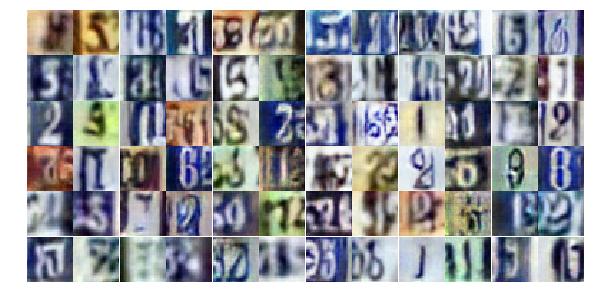

Epoch 13/25... Discriminator Loss: 1.1072... Generator Loss: 0.5733
Epoch 13/25... Discriminator Loss: 1.2367... Generator Loss: 1.9515
Epoch 13/25... Discriminator Loss: 0.8596... Generator Loss: 0.8200
Epoch 13/25... Discriminator Loss: 1.0556... Generator Loss: 0.5666
Epoch 13/25... Discriminator Loss: 0.6628... Generator Loss: 1.0403
Epoch 13/25... Discriminator Loss: 0.4338... Generator Loss: 1.5439
Epoch 13/25... Discriminator Loss: 0.5491... Generator Loss: 1.0939
Epoch 13/25... Discriminator Loss: 0.8444... Generator Loss: 1.2651
Epoch 13/25... Discriminator Loss: 0.6612... Generator Loss: 1.0088
Epoch 13/25... Discriminator Loss: 0.7674... Generator Loss: 0.9103


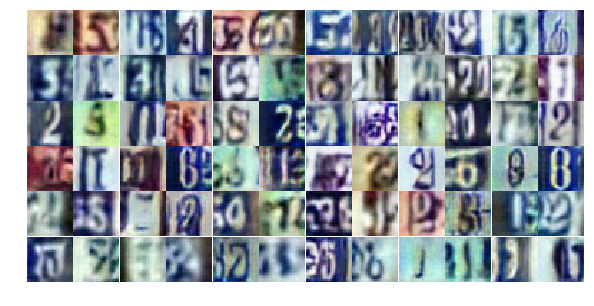

Epoch 13/25... Discriminator Loss: 0.6265... Generator Loss: 1.8911
Epoch 13/25... Discriminator Loss: 0.8840... Generator Loss: 1.4477
Epoch 13/25... Discriminator Loss: 1.1845... Generator Loss: 0.6846
Epoch 13/25... Discriminator Loss: 0.9025... Generator Loss: 0.7574
Epoch 13/25... Discriminator Loss: 0.8509... Generator Loss: 0.9615
Epoch 13/25... Discriminator Loss: 0.7301... Generator Loss: 1.0442
Epoch 13/25... Discriminator Loss: 1.0607... Generator Loss: 0.5852
Epoch 13/25... Discriminator Loss: 0.8221... Generator Loss: 0.9334
Epoch 13/25... Discriminator Loss: 0.7980... Generator Loss: 0.8694
Epoch 13/25... Discriminator Loss: 0.6833... Generator Loss: 0.9195


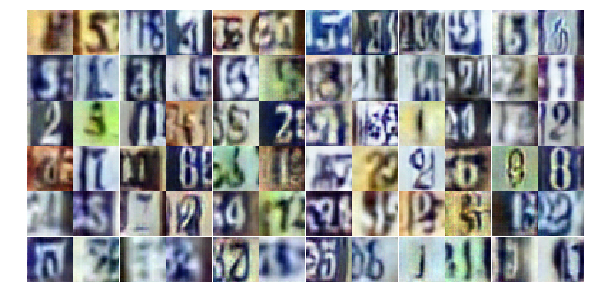

Epoch 13/25... Discriminator Loss: 0.3538... Generator Loss: 2.2161
Epoch 13/25... Discriminator Loss: 1.3614... Generator Loss: 0.4324
Epoch 13/25... Discriminator Loss: 0.6178... Generator Loss: 1.1705
Epoch 13/25... Discriminator Loss: 0.8002... Generator Loss: 0.7899
Epoch 14/25... Discriminator Loss: 0.9564... Generator Loss: 0.6465
Epoch 14/25... Discriminator Loss: 1.0025... Generator Loss: 0.7619
Epoch 14/25... Discriminator Loss: 1.0408... Generator Loss: 0.6315
Epoch 14/25... Discriminator Loss: 0.5211... Generator Loss: 1.4735
Epoch 14/25... Discriminator Loss: 0.6845... Generator Loss: 1.1084
Epoch 14/25... Discriminator Loss: 0.6860... Generator Loss: 0.9697


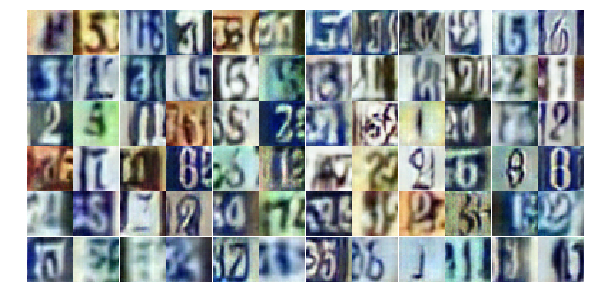

Epoch 14/25... Discriminator Loss: 0.9836... Generator Loss: 1.5539
Epoch 14/25... Discriminator Loss: 1.4956... Generator Loss: 0.4491
Epoch 14/25... Discriminator Loss: 0.9620... Generator Loss: 0.7193
Epoch 14/25... Discriminator Loss: 0.5672... Generator Loss: 1.3122
Epoch 14/25... Discriminator Loss: 0.9104... Generator Loss: 0.7463
Epoch 14/25... Discriminator Loss: 0.3852... Generator Loss: 1.4925
Epoch 14/25... Discriminator Loss: 0.4149... Generator Loss: 1.5175
Epoch 14/25... Discriminator Loss: 1.1522... Generator Loss: 0.5321
Epoch 14/25... Discriminator Loss: 1.1770... Generator Loss: 0.5189
Epoch 14/25... Discriminator Loss: 1.3042... Generator Loss: 0.4653


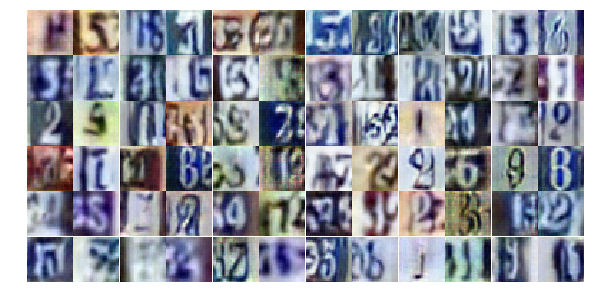

Epoch 14/25... Discriminator Loss: 0.5958... Generator Loss: 1.0425
Epoch 14/25... Discriminator Loss: 0.6307... Generator Loss: 2.8326
Epoch 14/25... Discriminator Loss: 0.9651... Generator Loss: 0.9567
Epoch 14/25... Discriminator Loss: 0.6595... Generator Loss: 1.1430
Epoch 14/25... Discriminator Loss: 0.9895... Generator Loss: 0.6946
Epoch 14/25... Discriminator Loss: 0.8865... Generator Loss: 0.7171
Epoch 14/25... Discriminator Loss: 0.8466... Generator Loss: 0.7878
Epoch 14/25... Discriminator Loss: 0.6404... Generator Loss: 1.1806
Epoch 14/25... Discriminator Loss: 0.4835... Generator Loss: 1.4280
Epoch 14/25... Discriminator Loss: 0.5198... Generator Loss: 1.5623


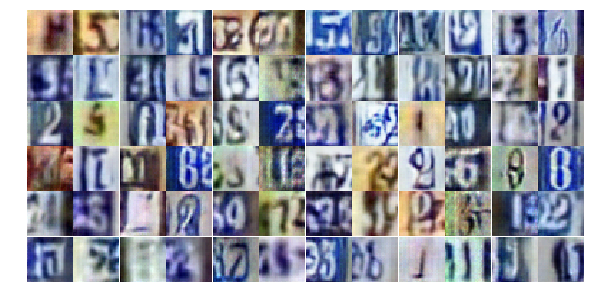

Epoch 14/25... Discriminator Loss: 1.2179... Generator Loss: 0.5129
Epoch 14/25... Discriminator Loss: 0.5362... Generator Loss: 1.4423
Epoch 14/25... Discriminator Loss: 0.5027... Generator Loss: 1.5138
Epoch 14/25... Discriminator Loss: 0.4006... Generator Loss: 1.5032
Epoch 14/25... Discriminator Loss: 0.6545... Generator Loss: 1.1417
Epoch 14/25... Discriminator Loss: 0.5910... Generator Loss: 1.3383
Epoch 14/25... Discriminator Loss: 0.8295... Generator Loss: 0.7592
Epoch 14/25... Discriminator Loss: 0.4541... Generator Loss: 1.5436
Epoch 14/25... Discriminator Loss: 0.3011... Generator Loss: 2.4757
Epoch 14/25... Discriminator Loss: 0.8820... Generator Loss: 1.4884


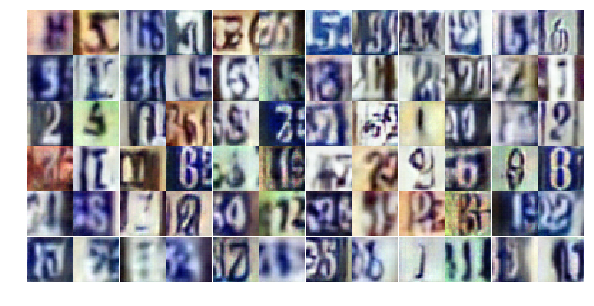

Epoch 14/25... Discriminator Loss: 1.1462... Generator Loss: 0.5609
Epoch 14/25... Discriminator Loss: 1.0895... Generator Loss: 0.7108
Epoch 14/25... Discriminator Loss: 0.9571... Generator Loss: 0.7473
Epoch 14/25... Discriminator Loss: 0.7318... Generator Loss: 0.9262
Epoch 14/25... Discriminator Loss: 0.8210... Generator Loss: 0.8940
Epoch 14/25... Discriminator Loss: 0.7636... Generator Loss: 1.0201
Epoch 14/25... Discriminator Loss: 0.6082... Generator Loss: 1.2268
Epoch 14/25... Discriminator Loss: 0.6151... Generator Loss: 1.1949
Epoch 14/25... Discriminator Loss: 1.1448... Generator Loss: 0.5442
Epoch 14/25... Discriminator Loss: 0.8894... Generator Loss: 1.6939


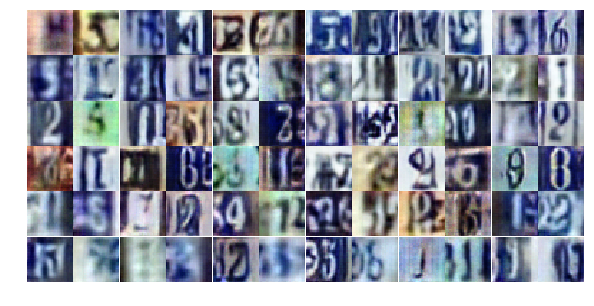

Epoch 14/25... Discriminator Loss: 0.8993... Generator Loss: 1.4873
Epoch 14/25... Discriminator Loss: 1.3896... Generator Loss: 0.4213
Epoch 14/25... Discriminator Loss: 0.8736... Generator Loss: 0.7893
Epoch 14/25... Discriminator Loss: 0.8765... Generator Loss: 0.7697
Epoch 14/25... Discriminator Loss: 0.5651... Generator Loss: 1.2579
Epoch 14/25... Discriminator Loss: 0.5927... Generator Loss: 1.3559
Epoch 14/25... Discriminator Loss: 0.5627... Generator Loss: 1.6114
Epoch 14/25... Discriminator Loss: 0.7951... Generator Loss: 0.9555
Epoch 14/25... Discriminator Loss: 1.1670... Generator Loss: 0.5019
Epoch 14/25... Discriminator Loss: 2.0566... Generator Loss: 0.1900


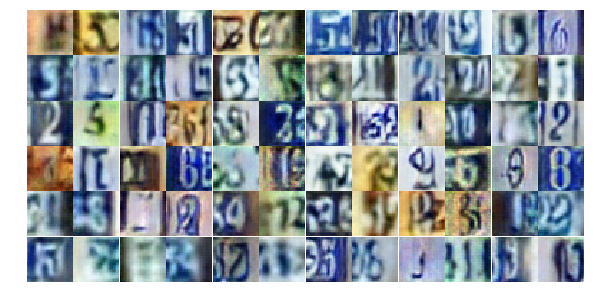

Epoch 14/25... Discriminator Loss: 0.9049... Generator Loss: 2.5786
Epoch 14/25... Discriminator Loss: 1.3032... Generator Loss: 0.5122
Epoch 15/25... Discriminator Loss: 0.7542... Generator Loss: 0.9882
Epoch 15/25... Discriminator Loss: 0.4803... Generator Loss: 1.5722
Epoch 15/25... Discriminator Loss: 0.6781... Generator Loss: 1.1682
Epoch 15/25... Discriminator Loss: 0.9852... Generator Loss: 0.7436
Epoch 15/25... Discriminator Loss: 0.7683... Generator Loss: 0.9701
Epoch 15/25... Discriminator Loss: 0.5047... Generator Loss: 1.5264
Epoch 15/25... Discriminator Loss: 0.9906... Generator Loss: 0.6966
Epoch 15/25... Discriminator Loss: 0.7749... Generator Loss: 0.8949


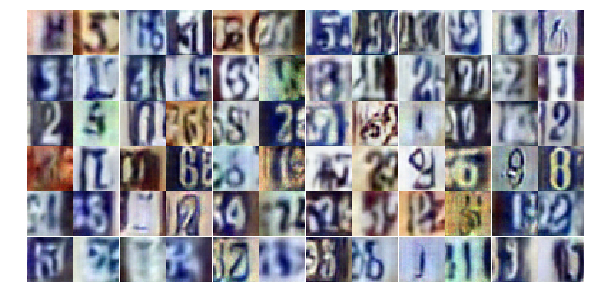

Epoch 15/25... Discriminator Loss: 0.6809... Generator Loss: 1.0380
Epoch 15/25... Discriminator Loss: 0.7583... Generator Loss: 0.9426
Epoch 15/25... Discriminator Loss: 1.0146... Generator Loss: 0.7456
Epoch 15/25... Discriminator Loss: 0.6405... Generator Loss: 1.2262
Epoch 15/25... Discriminator Loss: 0.8788... Generator Loss: 0.8527
Epoch 15/25... Discriminator Loss: 0.6801... Generator Loss: 0.9919
Epoch 15/25... Discriminator Loss: 1.0586... Generator Loss: 0.6022
Epoch 15/25... Discriminator Loss: 0.6627... Generator Loss: 1.8270
Epoch 15/25... Discriminator Loss: 1.0699... Generator Loss: 2.9728
Epoch 15/25... Discriminator Loss: 1.8541... Generator Loss: 0.2855


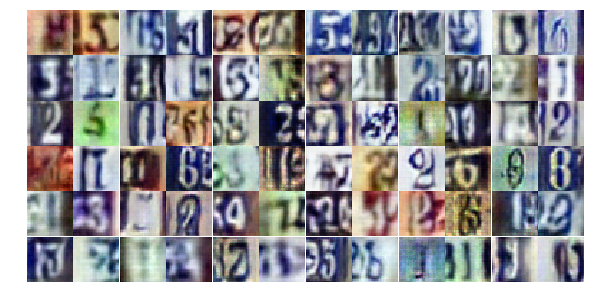

Epoch 15/25... Discriminator Loss: 1.2596... Generator Loss: 0.5959
Epoch 15/25... Discriminator Loss: 0.6567... Generator Loss: 1.1234
Epoch 15/25... Discriminator Loss: 0.5562... Generator Loss: 1.4075
Epoch 15/25... Discriminator Loss: 0.9192... Generator Loss: 0.7379
Epoch 15/25... Discriminator Loss: 1.3703... Generator Loss: 0.4661
Epoch 15/25... Discriminator Loss: 0.6246... Generator Loss: 1.2053
Epoch 15/25... Discriminator Loss: 1.1494... Generator Loss: 0.6413
Epoch 15/25... Discriminator Loss: 1.1584... Generator Loss: 0.5070
Epoch 15/25... Discriminator Loss: 0.6010... Generator Loss: 1.1438
Epoch 15/25... Discriminator Loss: 1.4959... Generator Loss: 0.3711


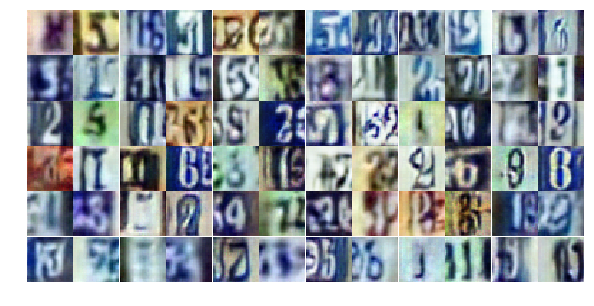

Epoch 15/25... Discriminator Loss: 0.6554... Generator Loss: 1.0858
Epoch 15/25... Discriminator Loss: 0.7261... Generator Loss: 0.9144
Epoch 15/25... Discriminator Loss: 0.4589... Generator Loss: 1.3210
Epoch 15/25... Discriminator Loss: 0.6900... Generator Loss: 1.0777
Epoch 15/25... Discriminator Loss: 0.5490... Generator Loss: 1.3364
Epoch 15/25... Discriminator Loss: 0.9678... Generator Loss: 1.8725
Epoch 15/25... Discriminator Loss: 1.2225... Generator Loss: 0.5215
Epoch 15/25... Discriminator Loss: 0.5414... Generator Loss: 1.3941
Epoch 15/25... Discriminator Loss: 0.5592... Generator Loss: 1.2274
Epoch 15/25... Discriminator Loss: 0.6972... Generator Loss: 1.0776


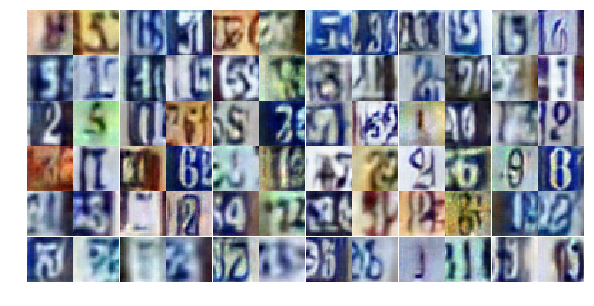

Epoch 15/25... Discriminator Loss: 0.5433... Generator Loss: 1.3214
Epoch 15/25... Discriminator Loss: 1.2344... Generator Loss: 0.5627
Epoch 15/25... Discriminator Loss: 0.6100... Generator Loss: 1.1057
Epoch 15/25... Discriminator Loss: 0.3493... Generator Loss: 2.0383
Epoch 15/25... Discriminator Loss: 0.7403... Generator Loss: 1.0335
Epoch 15/25... Discriminator Loss: 1.8278... Generator Loss: 0.2808
Epoch 15/25... Discriminator Loss: 0.4424... Generator Loss: 1.4434
Epoch 15/25... Discriminator Loss: 0.8063... Generator Loss: 1.7338
Epoch 15/25... Discriminator Loss: 1.6107... Generator Loss: 4.1203
Epoch 15/25... Discriminator Loss: 0.9092... Generator Loss: 0.9869


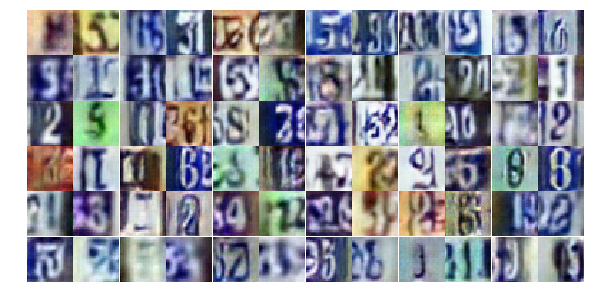

Epoch 15/25... Discriminator Loss: 0.9045... Generator Loss: 0.7914
Epoch 15/25... Discriminator Loss: 0.7557... Generator Loss: 1.2480
Epoch 15/25... Discriminator Loss: 0.5569... Generator Loss: 1.3284
Epoch 15/25... Discriminator Loss: 1.1028... Generator Loss: 0.6360
Epoch 15/25... Discriminator Loss: 0.7602... Generator Loss: 0.9138
Epoch 15/25... Discriminator Loss: 0.7340... Generator Loss: 0.9839
Epoch 15/25... Discriminator Loss: 0.8576... Generator Loss: 0.8072
Epoch 15/25... Discriminator Loss: 0.6465... Generator Loss: 1.2796
Epoch 15/25... Discriminator Loss: 1.8211... Generator Loss: 0.2331
Epoch 16/25... Discriminator Loss: 0.8742... Generator Loss: 0.7886


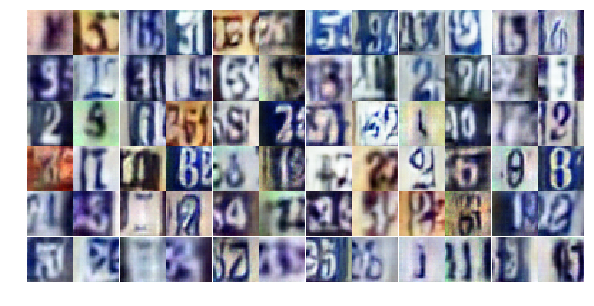

Epoch 16/25... Discriminator Loss: 0.6277... Generator Loss: 1.1136
Epoch 16/25... Discriminator Loss: 0.8124... Generator Loss: 0.8742
Epoch 16/25... Discriminator Loss: 1.0243... Generator Loss: 0.6370
Epoch 16/25... Discriminator Loss: 0.7814... Generator Loss: 0.8997
Epoch 16/25... Discriminator Loss: 0.6643... Generator Loss: 1.2480
Epoch 16/25... Discriminator Loss: 0.7338... Generator Loss: 0.9517
Epoch 16/25... Discriminator Loss: 1.6581... Generator Loss: 0.3132
Epoch 16/25... Discriminator Loss: 1.0135... Generator Loss: 0.6828
Epoch 16/25... Discriminator Loss: 0.7051... Generator Loss: 1.0383
Epoch 16/25... Discriminator Loss: 0.8066... Generator Loss: 0.8303


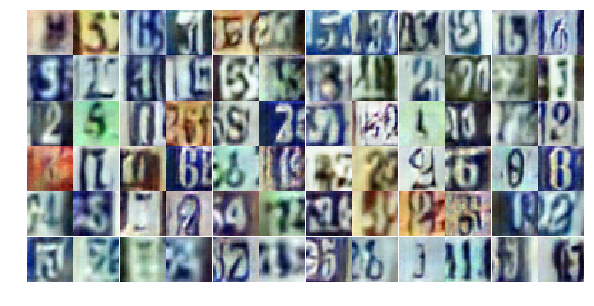

Epoch 16/25... Discriminator Loss: 1.2724... Generator Loss: 0.4594
Epoch 16/25... Discriminator Loss: 0.6573... Generator Loss: 1.0064
Epoch 16/25... Discriminator Loss: 0.6164... Generator Loss: 1.3921
Epoch 16/25... Discriminator Loss: 1.7466... Generator Loss: 0.3174
Epoch 16/25... Discriminator Loss: 0.6037... Generator Loss: 1.4449
Epoch 16/25... Discriminator Loss: 0.5728... Generator Loss: 1.3096
Epoch 16/25... Discriminator Loss: 1.1112... Generator Loss: 0.9183
Epoch 16/25... Discriminator Loss: 0.4058... Generator Loss: 1.9177
Epoch 16/25... Discriminator Loss: 0.6277... Generator Loss: 1.3524
Epoch 16/25... Discriminator Loss: 0.6688... Generator Loss: 1.0067


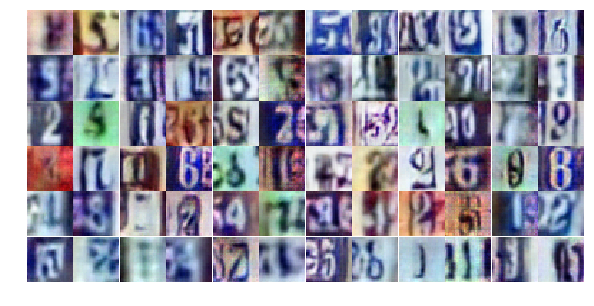

Epoch 16/25... Discriminator Loss: 0.9052... Generator Loss: 0.7735
Epoch 16/25... Discriminator Loss: 0.6197... Generator Loss: 1.3606
Epoch 16/25... Discriminator Loss: 0.9351... Generator Loss: 0.7088
Epoch 16/25... Discriminator Loss: 0.9204... Generator Loss: 0.7313
Epoch 16/25... Discriminator Loss: 0.8257... Generator Loss: 0.8920
Epoch 16/25... Discriminator Loss: 1.0026... Generator Loss: 0.6718
Epoch 16/25... Discriminator Loss: 0.7774... Generator Loss: 0.8687
Epoch 16/25... Discriminator Loss: 0.5867... Generator Loss: 1.1810
Epoch 16/25... Discriminator Loss: 0.7477... Generator Loss: 1.3420
Epoch 16/25... Discriminator Loss: 0.7349... Generator Loss: 0.9395


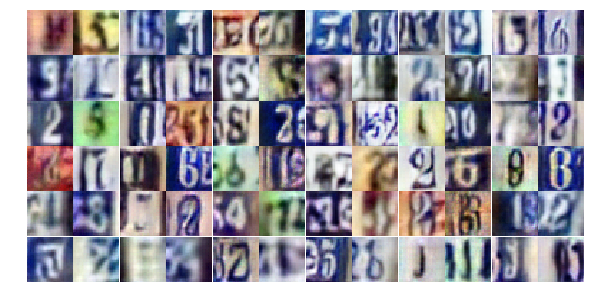

Epoch 16/25... Discriminator Loss: 0.6999... Generator Loss: 0.8815
Epoch 16/25... Discriminator Loss: 0.3877... Generator Loss: 1.6686
Epoch 16/25... Discriminator Loss: 0.6674... Generator Loss: 1.5557
Epoch 16/25... Discriminator Loss: 0.5011... Generator Loss: 1.5279
Epoch 16/25... Discriminator Loss: 0.8910... Generator Loss: 0.9900
Epoch 16/25... Discriminator Loss: 0.4557... Generator Loss: 1.5938
Epoch 16/25... Discriminator Loss: 0.6665... Generator Loss: 1.4968
Epoch 16/25... Discriminator Loss: 1.3413... Generator Loss: 0.4187
Epoch 16/25... Discriminator Loss: 0.6779... Generator Loss: 1.2816
Epoch 16/25... Discriminator Loss: 0.5117... Generator Loss: 1.3631


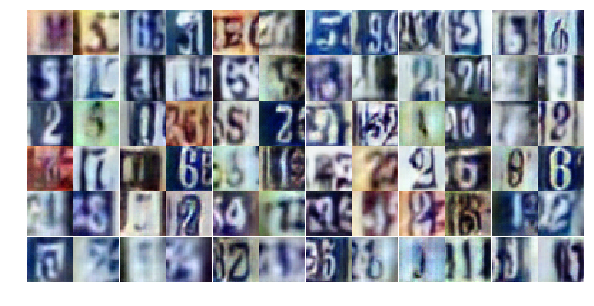

Epoch 16/25... Discriminator Loss: 0.5052... Generator Loss: 1.4741
Epoch 16/25... Discriminator Loss: 0.6162... Generator Loss: 1.3098
Epoch 16/25... Discriminator Loss: 1.1301... Generator Loss: 0.5103
Epoch 16/25... Discriminator Loss: 0.8525... Generator Loss: 1.0100
Epoch 16/25... Discriminator Loss: 0.9943... Generator Loss: 0.8132
Epoch 16/25... Discriminator Loss: 1.1088... Generator Loss: 0.7041
Epoch 16/25... Discriminator Loss: 0.4904... Generator Loss: 1.7059
Epoch 16/25... Discriminator Loss: 0.9147... Generator Loss: 0.7768
Epoch 16/25... Discriminator Loss: 0.4539... Generator Loss: 1.3820
Epoch 16/25... Discriminator Loss: 0.6839... Generator Loss: 1.0776


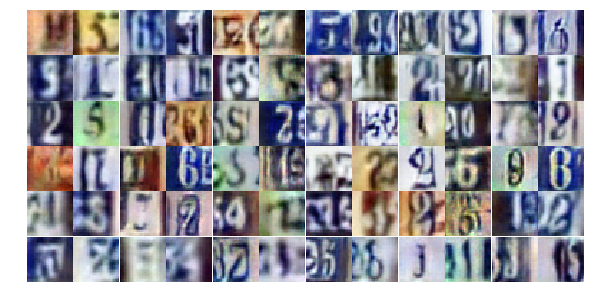

Epoch 16/25... Discriminator Loss: 1.5693... Generator Loss: 0.3271
Epoch 16/25... Discriminator Loss: 0.8304... Generator Loss: 0.9214
Epoch 16/25... Discriminator Loss: 1.9706... Generator Loss: 0.2296
Epoch 16/25... Discriminator Loss: 0.6203... Generator Loss: 1.0442
Epoch 16/25... Discriminator Loss: 0.7585... Generator Loss: 0.9876
Epoch 16/25... Discriminator Loss: 1.0872... Generator Loss: 3.0386
Epoch 17/25... Discriminator Loss: 0.6417... Generator Loss: 1.1728
Epoch 17/25... Discriminator Loss: 1.2006... Generator Loss: 0.5012
Epoch 17/25... Discriminator Loss: 0.8836... Generator Loss: 0.8663
Epoch 17/25... Discriminator Loss: 0.6984... Generator Loss: 1.1547


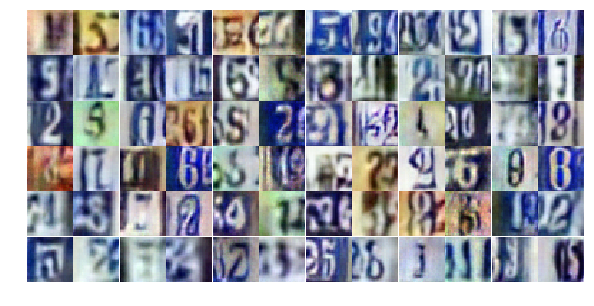

Epoch 17/25... Discriminator Loss: 0.5193... Generator Loss: 1.3959
Epoch 17/25... Discriminator Loss: 0.4577... Generator Loss: 1.6011
Epoch 17/25... Discriminator Loss: 1.2027... Generator Loss: 0.6096
Epoch 17/25... Discriminator Loss: 1.1200... Generator Loss: 0.5585
Epoch 17/25... Discriminator Loss: 1.1183... Generator Loss: 0.6387
Epoch 17/25... Discriminator Loss: 1.1325... Generator Loss: 0.5801
Epoch 17/25... Discriminator Loss: 1.0134... Generator Loss: 0.6409
Epoch 17/25... Discriminator Loss: 0.7165... Generator Loss: 0.8808
Epoch 17/25... Discriminator Loss: 0.4652... Generator Loss: 1.4657
Epoch 17/25... Discriminator Loss: 0.7699... Generator Loss: 0.9636


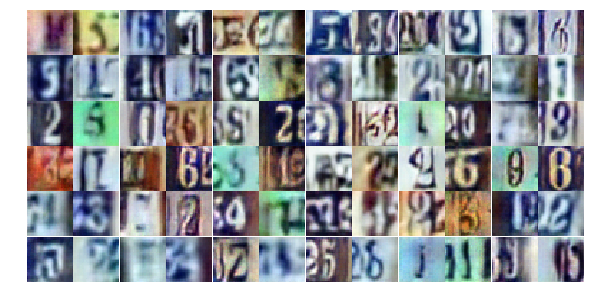

Epoch 17/25... Discriminator Loss: 0.8014... Generator Loss: 1.1450
Epoch 17/25... Discriminator Loss: 0.6534... Generator Loss: 1.4271
Epoch 17/25... Discriminator Loss: 0.7791... Generator Loss: 0.8384
Epoch 17/25... Discriminator Loss: 0.8762... Generator Loss: 0.8220
Epoch 17/25... Discriminator Loss: 0.4858... Generator Loss: 1.4362
Epoch 17/25... Discriminator Loss: 1.1905... Generator Loss: 0.5643
Epoch 17/25... Discriminator Loss: 0.5410... Generator Loss: 1.2507
Epoch 17/25... Discriminator Loss: 0.6494... Generator Loss: 1.0893
Epoch 17/25... Discriminator Loss: 1.1189... Generator Loss: 0.5589
Epoch 17/25... Discriminator Loss: 0.5002... Generator Loss: 1.3090


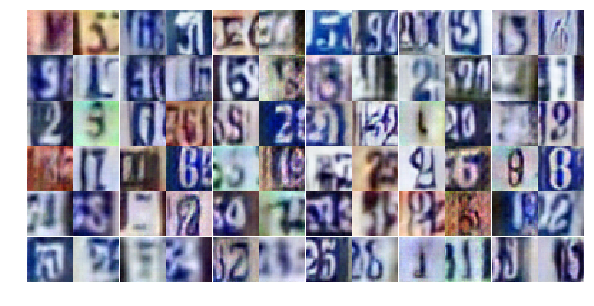

Epoch 17/25... Discriminator Loss: 2.1410... Generator Loss: 0.1964
Epoch 17/25... Discriminator Loss: 0.5287... Generator Loss: 1.4822
Epoch 17/25... Discriminator Loss: 0.5672... Generator Loss: 1.2502
Epoch 17/25... Discriminator Loss: 0.8674... Generator Loss: 0.7803
Epoch 17/25... Discriminator Loss: 1.4167... Generator Loss: 0.3784
Epoch 17/25... Discriminator Loss: 0.6026... Generator Loss: 1.1095
Epoch 17/25... Discriminator Loss: 0.6985... Generator Loss: 1.0404
Epoch 17/25... Discriminator Loss: 0.8137... Generator Loss: 0.8207
Epoch 17/25... Discriminator Loss: 0.9675... Generator Loss: 0.7417
Epoch 17/25... Discriminator Loss: 0.3728... Generator Loss: 1.9416


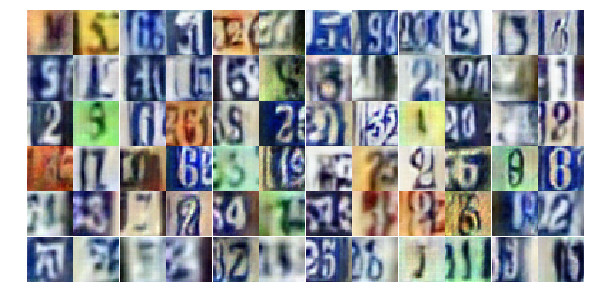

Epoch 17/25... Discriminator Loss: 1.1237... Generator Loss: 0.6295
Epoch 17/25... Discriminator Loss: 0.9547... Generator Loss: 0.8486
Epoch 17/25... Discriminator Loss: 0.5444... Generator Loss: 1.8086
Epoch 17/25... Discriminator Loss: 0.8059... Generator Loss: 1.6154
Epoch 17/25... Discriminator Loss: 1.0132... Generator Loss: 0.6756
Epoch 17/25... Discriminator Loss: 0.6167... Generator Loss: 1.5243
Epoch 17/25... Discriminator Loss: 0.7648... Generator Loss: 0.9795
Epoch 17/25... Discriminator Loss: 0.5168... Generator Loss: 1.5002
Epoch 17/25... Discriminator Loss: 0.3406... Generator Loss: 1.8361
Epoch 17/25... Discriminator Loss: 0.8638... Generator Loss: 0.7261


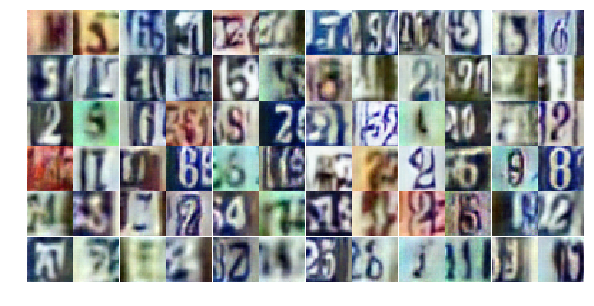

Epoch 17/25... Discriminator Loss: 1.0230... Generator Loss: 0.8930
Epoch 17/25... Discriminator Loss: 0.5262... Generator Loss: 3.3388
Epoch 17/25... Discriminator Loss: 0.8447... Generator Loss: 2.5641
Epoch 17/25... Discriminator Loss: 0.5359... Generator Loss: 1.5171
Epoch 17/25... Discriminator Loss: 0.9205... Generator Loss: 0.7754
Epoch 17/25... Discriminator Loss: 0.9866... Generator Loss: 0.6654
Epoch 17/25... Discriminator Loss: 1.6144... Generator Loss: 0.2998
Epoch 17/25... Discriminator Loss: 0.6112... Generator Loss: 1.2374
Epoch 17/25... Discriminator Loss: 0.6566... Generator Loss: 1.0899
Epoch 17/25... Discriminator Loss: 1.6973... Generator Loss: 0.3076


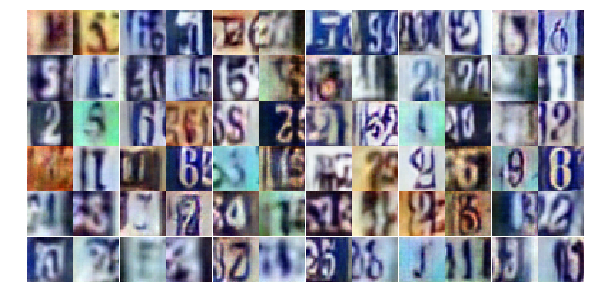

Epoch 17/25... Discriminator Loss: 0.9335... Generator Loss: 1.5718
Epoch 17/25... Discriminator Loss: 1.0537... Generator Loss: 2.4518
Epoch 17/25... Discriminator Loss: 0.6790... Generator Loss: 1.1107
Epoch 17/25... Discriminator Loss: 0.7477... Generator Loss: 0.9146
Epoch 18/25... Discriminator Loss: 0.9962... Generator Loss: 0.6912
Epoch 18/25... Discriminator Loss: 1.1514... Generator Loss: 0.5598
Epoch 18/25... Discriminator Loss: 0.7957... Generator Loss: 0.9589
Epoch 18/25... Discriminator Loss: 0.7197... Generator Loss: 0.9287
Epoch 18/25... Discriminator Loss: 1.3682... Generator Loss: 0.4151
Epoch 18/25... Discriminator Loss: 0.6980... Generator Loss: 1.0070


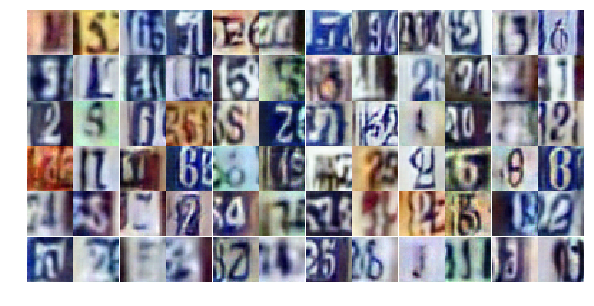

Epoch 18/25... Discriminator Loss: 0.7612... Generator Loss: 2.4735
Epoch 18/25... Discriminator Loss: 1.9610... Generator Loss: 0.2151
Epoch 18/25... Discriminator Loss: 0.8678... Generator Loss: 0.8204
Epoch 18/25... Discriminator Loss: 0.3869... Generator Loss: 1.8247
Epoch 18/25... Discriminator Loss: 0.5994... Generator Loss: 1.2012
Epoch 18/25... Discriminator Loss: 0.7188... Generator Loss: 1.3320
Epoch 18/25... Discriminator Loss: 0.6507... Generator Loss: 1.0468
Epoch 18/25... Discriminator Loss: 1.2282... Generator Loss: 0.5410
Epoch 18/25... Discriminator Loss: 0.6715... Generator Loss: 2.1225
Epoch 18/25... Discriminator Loss: 0.4868... Generator Loss: 2.8549


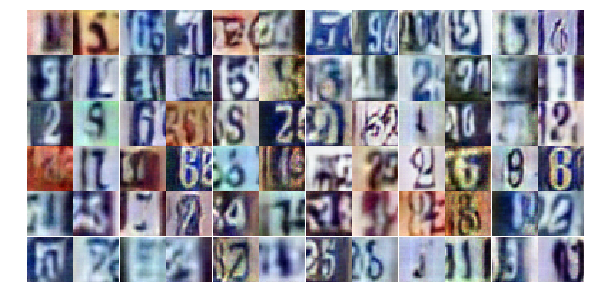

Epoch 18/25... Discriminator Loss: 0.9633... Generator Loss: 0.7499
Epoch 18/25... Discriminator Loss: 1.0447... Generator Loss: 1.4521
Epoch 18/25... Discriminator Loss: 0.8689... Generator Loss: 1.2847
Epoch 18/25... Discriminator Loss: 0.6519... Generator Loss: 1.3070
Epoch 18/25... Discriminator Loss: 0.8189... Generator Loss: 0.8351
Epoch 18/25... Discriminator Loss: 1.0507... Generator Loss: 0.6763
Epoch 18/25... Discriminator Loss: 1.0796... Generator Loss: 0.6974
Epoch 18/25... Discriminator Loss: 0.9977... Generator Loss: 0.6620
Epoch 18/25... Discriminator Loss: 0.7889... Generator Loss: 0.9296
Epoch 18/25... Discriminator Loss: 0.6165... Generator Loss: 1.1019


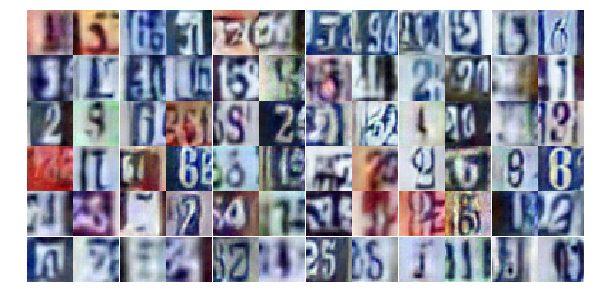

Epoch 18/25... Discriminator Loss: 0.4005... Generator Loss: 1.5658
Epoch 18/25... Discriminator Loss: 0.6850... Generator Loss: 1.2511
Epoch 18/25... Discriminator Loss: 0.7902... Generator Loss: 0.9267
Epoch 18/25... Discriminator Loss: 0.8299... Generator Loss: 0.9207
Epoch 18/25... Discriminator Loss: 1.0284... Generator Loss: 0.6758
Epoch 18/25... Discriminator Loss: 0.5813... Generator Loss: 1.2697
Epoch 18/25... Discriminator Loss: 0.9454... Generator Loss: 0.7064
Epoch 18/25... Discriminator Loss: 0.6111... Generator Loss: 2.4604
Epoch 18/25... Discriminator Loss: 0.5224... Generator Loss: 1.2719
Epoch 18/25... Discriminator Loss: 0.6578... Generator Loss: 1.0667


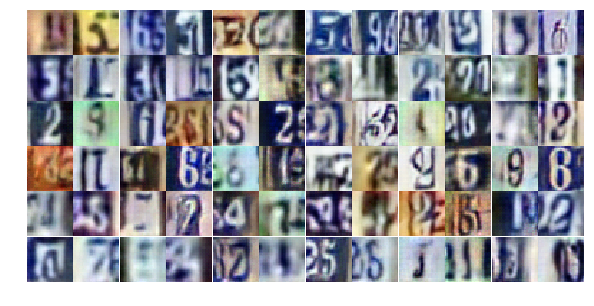

Epoch 18/25... Discriminator Loss: 0.9244... Generator Loss: 0.7982
Epoch 18/25... Discriminator Loss: 0.8794... Generator Loss: 0.7794
Epoch 18/25... Discriminator Loss: 0.7427... Generator Loss: 0.9822
Epoch 18/25... Discriminator Loss: 0.8906... Generator Loss: 0.7480
Epoch 18/25... Discriminator Loss: 0.9688... Generator Loss: 0.6581
Epoch 18/25... Discriminator Loss: 0.6845... Generator Loss: 1.0010
Epoch 18/25... Discriminator Loss: 0.8413... Generator Loss: 0.8110
Epoch 18/25... Discriminator Loss: 2.5458... Generator Loss: 4.0980
Epoch 18/25... Discriminator Loss: 1.1079... Generator Loss: 0.7621
Epoch 18/25... Discriminator Loss: 0.4039... Generator Loss: 1.7829


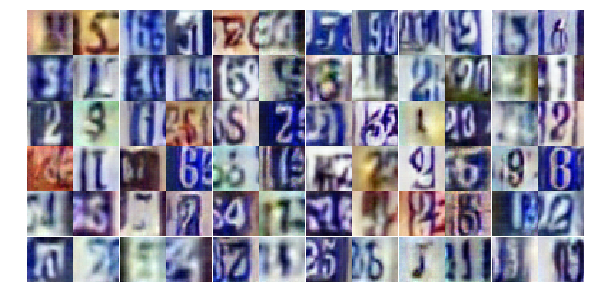

Epoch 18/25... Discriminator Loss: 0.7639... Generator Loss: 1.0964
Epoch 18/25... Discriminator Loss: 0.7059... Generator Loss: 1.1177
Epoch 18/25... Discriminator Loss: 0.8685... Generator Loss: 0.7786
Epoch 18/25... Discriminator Loss: 0.9812... Generator Loss: 0.7011
Epoch 18/25... Discriminator Loss: 0.7581... Generator Loss: 0.8785
Epoch 18/25... Discriminator Loss: 0.6796... Generator Loss: 1.3788
Epoch 18/25... Discriminator Loss: 0.7369... Generator Loss: 0.9752
Epoch 18/25... Discriminator Loss: 0.5233... Generator Loss: 1.4442
Epoch 18/25... Discriminator Loss: 0.9546... Generator Loss: 0.6841
Epoch 18/25... Discriminator Loss: 1.0464... Generator Loss: 0.6577


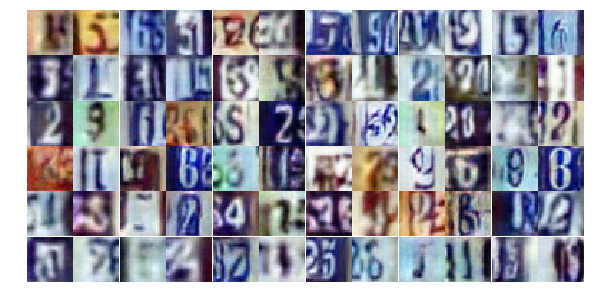

Epoch 18/25... Discriminator Loss: 0.8194... Generator Loss: 1.0016
Epoch 19/25... Discriminator Loss: 0.8525... Generator Loss: 1.6323
Epoch 19/25... Discriminator Loss: 1.0683... Generator Loss: 0.6046
Epoch 19/25... Discriminator Loss: 0.7973... Generator Loss: 1.2033
Epoch 19/25... Discriminator Loss: 0.5661... Generator Loss: 1.1471
Epoch 19/25... Discriminator Loss: 1.2048... Generator Loss: 0.4889
Epoch 19/25... Discriminator Loss: 0.4679... Generator Loss: 1.4856
Epoch 19/25... Discriminator Loss: 0.7003... Generator Loss: 1.2458
Epoch 19/25... Discriminator Loss: 0.6522... Generator Loss: 2.3310
Epoch 19/25... Discriminator Loss: 1.0818... Generator Loss: 0.6410


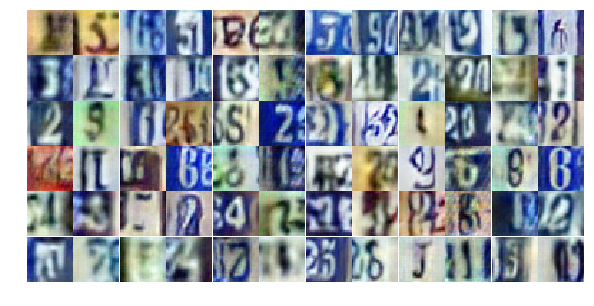

Epoch 19/25... Discriminator Loss: 0.6573... Generator Loss: 1.0364
Epoch 19/25... Discriminator Loss: 0.8211... Generator Loss: 0.8699
Epoch 19/25... Discriminator Loss: 0.7031... Generator Loss: 1.3388
Epoch 19/25... Discriminator Loss: 0.9355... Generator Loss: 0.7061
Epoch 19/25... Discriminator Loss: 1.2350... Generator Loss: 0.4973
Epoch 19/25... Discriminator Loss: 0.6285... Generator Loss: 1.6181
Epoch 19/25... Discriminator Loss: 1.3528... Generator Loss: 0.4786
Epoch 19/25... Discriminator Loss: 0.5064... Generator Loss: 1.4506
Epoch 19/25... Discriminator Loss: 0.8621... Generator Loss: 1.7107
Epoch 19/25... Discriminator Loss: 1.1256... Generator Loss: 0.6114


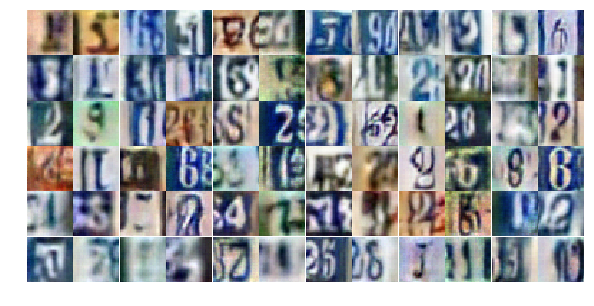

Epoch 19/25... Discriminator Loss: 1.0586... Generator Loss: 0.6794
Epoch 19/25... Discriminator Loss: 1.2734... Generator Loss: 0.4747
Epoch 19/25... Discriminator Loss: 1.2927... Generator Loss: 0.5223
Epoch 19/25... Discriminator Loss: 1.0304... Generator Loss: 0.7287
Epoch 19/25... Discriminator Loss: 0.7978... Generator Loss: 1.0133
Epoch 19/25... Discriminator Loss: 0.7473... Generator Loss: 0.9240
Epoch 19/25... Discriminator Loss: 1.1376... Generator Loss: 0.6484
Epoch 19/25... Discriminator Loss: 0.3436... Generator Loss: 1.6979
Epoch 19/25... Discriminator Loss: 0.5267... Generator Loss: 1.5706
Epoch 19/25... Discriminator Loss: 1.0876... Generator Loss: 0.6325


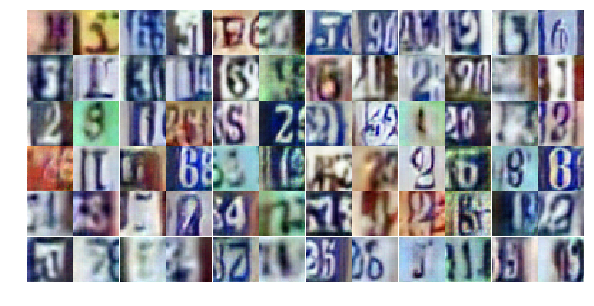

Epoch 19/25... Discriminator Loss: 1.0521... Generator Loss: 0.6623
Epoch 19/25... Discriminator Loss: 0.6661... Generator Loss: 0.9934
Epoch 19/25... Discriminator Loss: 0.8844... Generator Loss: 0.7686
Epoch 19/25... Discriminator Loss: 0.8399... Generator Loss: 0.7968
Epoch 19/25... Discriminator Loss: 0.6509... Generator Loss: 1.1298
Epoch 19/25... Discriminator Loss: 0.7269... Generator Loss: 0.9508
Epoch 19/25... Discriminator Loss: 0.6383... Generator Loss: 1.2698
Epoch 19/25... Discriminator Loss: 0.5692... Generator Loss: 1.5948
Epoch 19/25... Discriminator Loss: 0.8435... Generator Loss: 1.0255
Epoch 19/25... Discriminator Loss: 0.6265... Generator Loss: 1.0568


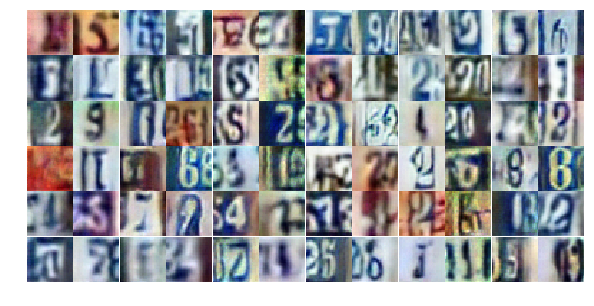

Epoch 19/25... Discriminator Loss: 0.4506... Generator Loss: 1.5178
Epoch 19/25... Discriminator Loss: 0.6721... Generator Loss: 1.1335
Epoch 19/25... Discriminator Loss: 1.4654... Generator Loss: 0.4009
Epoch 19/25... Discriminator Loss: 0.7742... Generator Loss: 0.9297
Epoch 19/25... Discriminator Loss: 1.1532... Generator Loss: 0.5775
Epoch 19/25... Discriminator Loss: 0.6480... Generator Loss: 1.4549
Epoch 19/25... Discriminator Loss: 1.2567... Generator Loss: 0.6095
Epoch 19/25... Discriminator Loss: 0.4642... Generator Loss: 2.3370
Epoch 19/25... Discriminator Loss: 0.5701... Generator Loss: 1.2537
Epoch 19/25... Discriminator Loss: 1.2431... Generator Loss: 0.4891


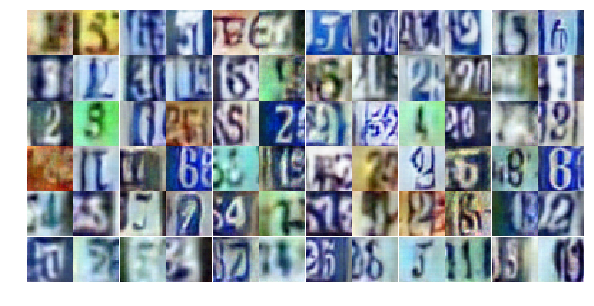

Epoch 19/25... Discriminator Loss: 1.0598... Generator Loss: 0.7109
Epoch 19/25... Discriminator Loss: 0.7812... Generator Loss: 1.7694
Epoch 19/25... Discriminator Loss: 0.5406... Generator Loss: 1.4159
Epoch 19/25... Discriminator Loss: 0.8153... Generator Loss: 1.0615
Epoch 19/25... Discriminator Loss: 1.3490... Generator Loss: 2.5201
Epoch 19/25... Discriminator Loss: 0.9541... Generator Loss: 0.7891
Epoch 19/25... Discriminator Loss: 1.2310... Generator Loss: 0.5698
Epoch 19/25... Discriminator Loss: 0.7116... Generator Loss: 1.1601
Epoch 20/25... Discriminator Loss: 0.7374... Generator Loss: 1.0265
Epoch 20/25... Discriminator Loss: 0.7152... Generator Loss: 1.4386


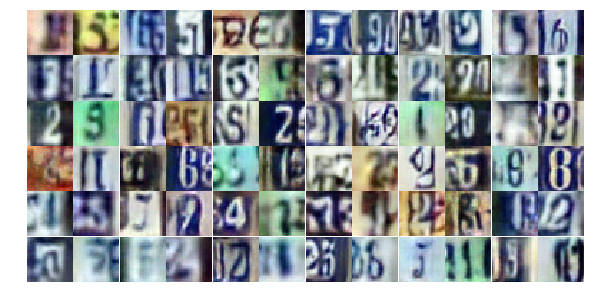

Epoch 20/25... Discriminator Loss: 0.5781... Generator Loss: 1.6761
Epoch 20/25... Discriminator Loss: 0.9229... Generator Loss: 0.6719
Epoch 20/25... Discriminator Loss: 1.6532... Generator Loss: 0.3215
Epoch 20/25... Discriminator Loss: 1.2660... Generator Loss: 0.4553
Epoch 20/25... Discriminator Loss: 0.5366... Generator Loss: 1.4508
Epoch 20/25... Discriminator Loss: 0.4929... Generator Loss: 1.8797
Epoch 20/25... Discriminator Loss: 0.6899... Generator Loss: 1.9572
Epoch 20/25... Discriminator Loss: 0.7657... Generator Loss: 1.1899
Epoch 20/25... Discriminator Loss: 0.6935... Generator Loss: 1.1643
Epoch 20/25... Discriminator Loss: 0.8639... Generator Loss: 0.7321


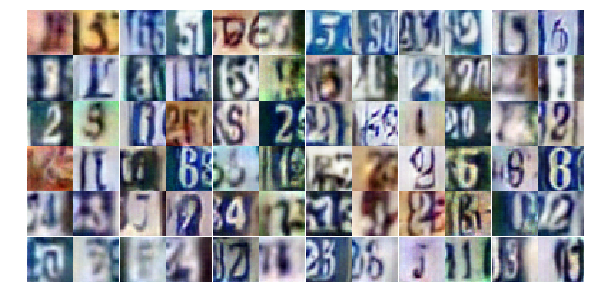

Epoch 20/25... Discriminator Loss: 1.1848... Generator Loss: 0.6360
Epoch 20/25... Discriminator Loss: 0.9773... Generator Loss: 0.7482
Epoch 20/25... Discriminator Loss: 0.8256... Generator Loss: 0.9841
Epoch 20/25... Discriminator Loss: 0.7611... Generator Loss: 0.9767
Epoch 20/25... Discriminator Loss: 1.0838... Generator Loss: 0.5983
Epoch 20/25... Discriminator Loss: 1.3209... Generator Loss: 0.4541
Epoch 20/25... Discriminator Loss: 0.9429... Generator Loss: 0.7376
Epoch 20/25... Discriminator Loss: 0.6291... Generator Loss: 1.2113
Epoch 20/25... Discriminator Loss: 0.6373... Generator Loss: 1.2641
Epoch 20/25... Discriminator Loss: 1.1971... Generator Loss: 0.5985


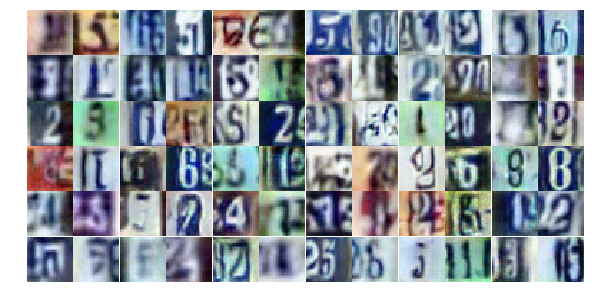

Epoch 20/25... Discriminator Loss: 0.5205... Generator Loss: 1.2829
Epoch 20/25... Discriminator Loss: 0.9392... Generator Loss: 0.7242
Epoch 20/25... Discriminator Loss: 0.4415... Generator Loss: 1.4649
Epoch 20/25... Discriminator Loss: 1.5742... Generator Loss: 0.3605
Epoch 20/25... Discriminator Loss: 0.8271... Generator Loss: 0.8870
Epoch 20/25... Discriminator Loss: 0.5714... Generator Loss: 1.1430
Epoch 20/25... Discriminator Loss: 0.5720... Generator Loss: 1.5773
Epoch 20/25... Discriminator Loss: 1.8310... Generator Loss: 0.3180
Epoch 20/25... Discriminator Loss: 0.9503... Generator Loss: 0.7488
Epoch 20/25... Discriminator Loss: 0.5720... Generator Loss: 1.1259


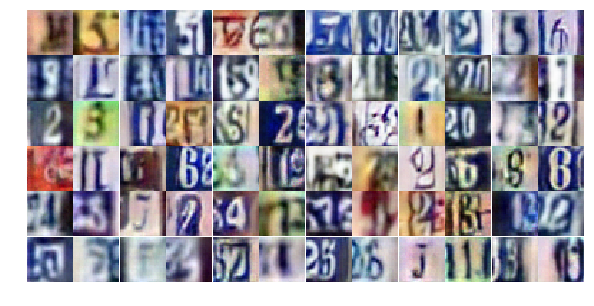

Epoch 20/25... Discriminator Loss: 0.7739... Generator Loss: 1.7799
Epoch 20/25... Discriminator Loss: 0.7978... Generator Loss: 0.8457
Epoch 20/25... Discriminator Loss: 0.8823... Generator Loss: 0.8469
Epoch 20/25... Discriminator Loss: 0.7961... Generator Loss: 0.9385
Epoch 20/25... Discriminator Loss: 1.2145... Generator Loss: 0.5190
Epoch 20/25... Discriminator Loss: 0.8427... Generator Loss: 0.8244
Epoch 20/25... Discriminator Loss: 0.8374... Generator Loss: 1.3422
Epoch 20/25... Discriminator Loss: 0.6542... Generator Loss: 1.4752
Epoch 20/25... Discriminator Loss: 0.9326... Generator Loss: 2.0607
Epoch 20/25... Discriminator Loss: 1.3052... Generator Loss: 0.5068


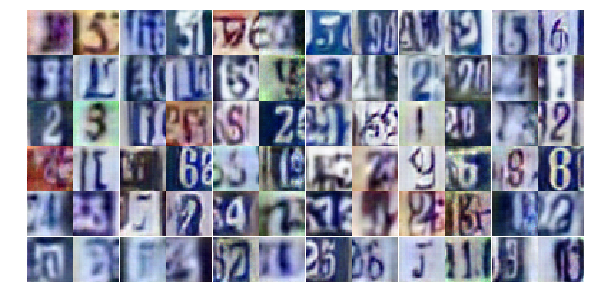

Epoch 20/25... Discriminator Loss: 0.8318... Generator Loss: 0.8700
Epoch 20/25... Discriminator Loss: 0.8438... Generator Loss: 0.9751
Epoch 20/25... Discriminator Loss: 1.6892... Generator Loss: 1.5738
Epoch 20/25... Discriminator Loss: 5.3231... Generator Loss: 0.1666
Epoch 20/25... Discriminator Loss: 1.3057... Generator Loss: 1.1738
Epoch 20/25... Discriminator Loss: 1.3298... Generator Loss: 0.5638
Epoch 20/25... Discriminator Loss: 0.9740... Generator Loss: 0.7847
Epoch 20/25... Discriminator Loss: 0.6090... Generator Loss: 1.2967
Epoch 20/25... Discriminator Loss: 0.7044... Generator Loss: 1.1611
Epoch 20/25... Discriminator Loss: 0.7819... Generator Loss: 0.9822


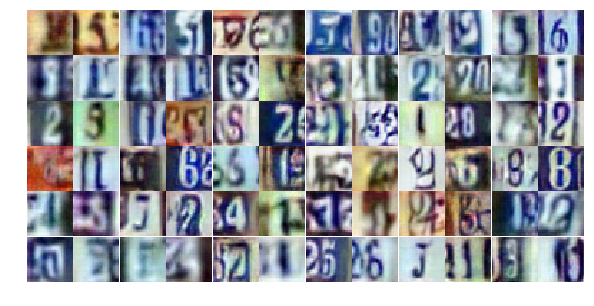

Epoch 20/25... Discriminator Loss: 0.8919... Generator Loss: 0.8085
Epoch 20/25... Discriminator Loss: 0.6486... Generator Loss: 1.4113
Epoch 20/25... Discriminator Loss: 0.5826... Generator Loss: 1.3964
Epoch 20/25... Discriminator Loss: 0.9323... Generator Loss: 1.0409
Epoch 20/25... Discriminator Loss: 0.7220... Generator Loss: 0.9827
Epoch 20/25... Discriminator Loss: 0.8781... Generator Loss: 0.8194
Epoch 21/25... Discriminator Loss: 1.1854... Generator Loss: 0.5074
Epoch 21/25... Discriminator Loss: 1.1661... Generator Loss: 0.5199
Epoch 21/25... Discriminator Loss: 1.1849... Generator Loss: 0.5570
Epoch 21/25... Discriminator Loss: 0.8323... Generator Loss: 0.8435


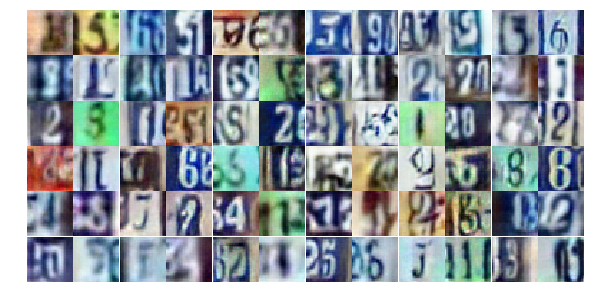

Epoch 21/25... Discriminator Loss: 0.8634... Generator Loss: 0.9263
Epoch 21/25... Discriminator Loss: 1.4655... Generator Loss: 0.4321
Epoch 21/25... Discriminator Loss: 0.6413... Generator Loss: 1.3172
Epoch 21/25... Discriminator Loss: 0.4812... Generator Loss: 1.3976
Epoch 21/25... Discriminator Loss: 0.8674... Generator Loss: 0.8538
Epoch 21/25... Discriminator Loss: 0.3714... Generator Loss: 1.7559
Epoch 21/25... Discriminator Loss: 1.0861... Generator Loss: 0.6508
Epoch 21/25... Discriminator Loss: 1.2773... Generator Loss: 0.4731
Epoch 21/25... Discriminator Loss: 0.9208... Generator Loss: 0.7200
Epoch 21/25... Discriminator Loss: 1.0066... Generator Loss: 0.6994


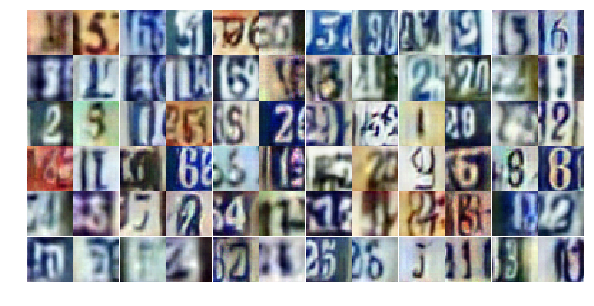

Epoch 21/25... Discriminator Loss: 0.2926... Generator Loss: 1.9110
Epoch 21/25... Discriminator Loss: 0.6738... Generator Loss: 0.9824
Epoch 21/25... Discriminator Loss: 1.4599... Generator Loss: 0.4560
Epoch 21/25... Discriminator Loss: 1.0257... Generator Loss: 0.6372
Epoch 21/25... Discriminator Loss: 0.5785... Generator Loss: 1.2019
Epoch 21/25... Discriminator Loss: 1.0121... Generator Loss: 0.7309
Epoch 21/25... Discriminator Loss: 0.8061... Generator Loss: 0.9241
Epoch 21/25... Discriminator Loss: 0.5189... Generator Loss: 1.3636
Epoch 21/25... Discriminator Loss: 0.7798... Generator Loss: 0.8786
Epoch 21/25... Discriminator Loss: 0.6659... Generator Loss: 1.1499


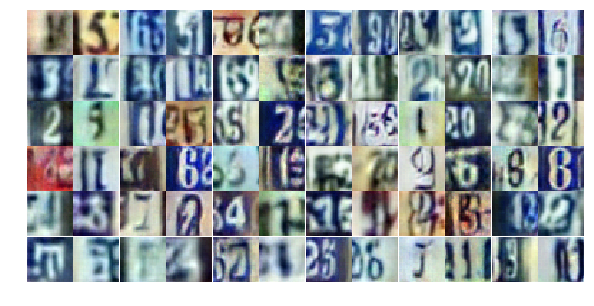

Epoch 21/25... Discriminator Loss: 1.3012... Generator Loss: 0.4900
Epoch 21/25... Discriminator Loss: 0.5345... Generator Loss: 1.3015
Epoch 21/25... Discriminator Loss: 1.3819... Generator Loss: 0.5135
Epoch 21/25... Discriminator Loss: 0.9927... Generator Loss: 0.6742
Epoch 21/25... Discriminator Loss: 0.9564... Generator Loss: 0.6999
Epoch 21/25... Discriminator Loss: 1.0674... Generator Loss: 0.6242
Epoch 21/25... Discriminator Loss: 0.6933... Generator Loss: 0.9478
Epoch 21/25... Discriminator Loss: 1.0707... Generator Loss: 0.6242
Epoch 21/25... Discriminator Loss: 1.7982... Generator Loss: 0.2714
Epoch 21/25... Discriminator Loss: 1.9580... Generator Loss: 0.2762


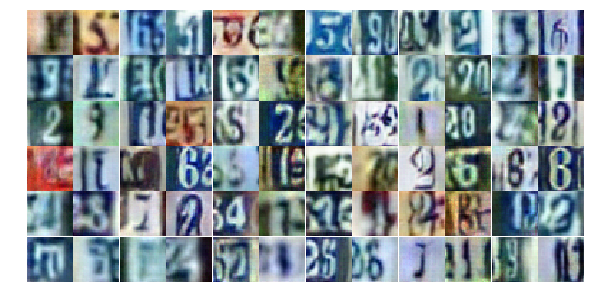

Epoch 21/25... Discriminator Loss: 0.8017... Generator Loss: 1.3201
Epoch 21/25... Discriminator Loss: 1.0061... Generator Loss: 0.6598
Epoch 21/25... Discriminator Loss: 1.0685... Generator Loss: 0.5853
Epoch 21/25... Discriminator Loss: 0.5851... Generator Loss: 1.1490
Epoch 21/25... Discriminator Loss: 0.6462... Generator Loss: 1.0632
Epoch 21/25... Discriminator Loss: 0.8900... Generator Loss: 0.8506
Epoch 21/25... Discriminator Loss: 0.8682... Generator Loss: 0.7738
Epoch 21/25... Discriminator Loss: 0.8623... Generator Loss: 0.8528
Epoch 21/25... Discriminator Loss: 0.5734... Generator Loss: 1.3348
Epoch 21/25... Discriminator Loss: 0.3031... Generator Loss: 2.6940


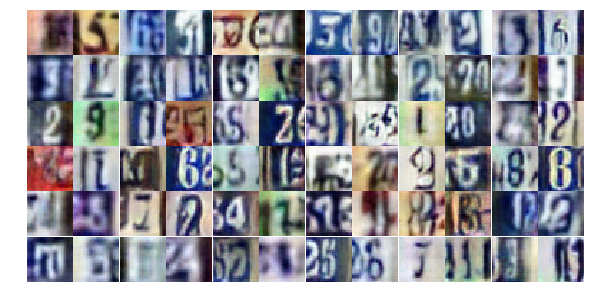

Epoch 21/25... Discriminator Loss: 0.8337... Generator Loss: 1.1389
Epoch 21/25... Discriminator Loss: 1.7105... Generator Loss: 0.3272
Epoch 21/25... Discriminator Loss: 0.6124... Generator Loss: 1.1746
Epoch 21/25... Discriminator Loss: 0.8829... Generator Loss: 0.8053
Epoch 21/25... Discriminator Loss: 0.5059... Generator Loss: 1.3787
Epoch 21/25... Discriminator Loss: 1.0906... Generator Loss: 0.5819
Epoch 21/25... Discriminator Loss: 1.3107... Generator Loss: 0.5520
Epoch 21/25... Discriminator Loss: 0.6850... Generator Loss: 0.9959
Epoch 21/25... Discriminator Loss: 1.0095... Generator Loss: 0.6326
Epoch 21/25... Discriminator Loss: 1.2700... Generator Loss: 0.5301


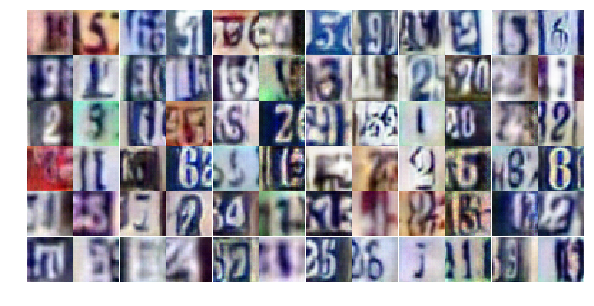

Epoch 21/25... Discriminator Loss: 0.6716... Generator Loss: 1.1776
Epoch 21/25... Discriminator Loss: 1.1019... Generator Loss: 0.6435
Epoch 21/25... Discriminator Loss: 0.6370... Generator Loss: 1.0925
Epoch 22/25... Discriminator Loss: 0.6782... Generator Loss: 1.4544
Epoch 22/25... Discriminator Loss: 1.1212... Generator Loss: 0.5878
Epoch 22/25... Discriminator Loss: 0.7052... Generator Loss: 1.2369
Epoch 22/25... Discriminator Loss: 0.6145... Generator Loss: 1.1755
Epoch 22/25... Discriminator Loss: 0.6687... Generator Loss: 0.9395
Epoch 22/25... Discriminator Loss: 1.3687... Generator Loss: 0.4550
Epoch 22/25... Discriminator Loss: 1.1614... Generator Loss: 0.6793


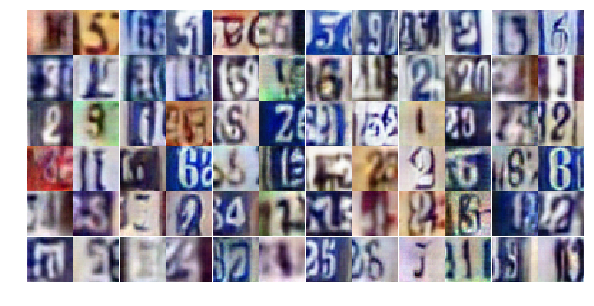

Epoch 22/25... Discriminator Loss: 0.5721... Generator Loss: 1.4078
Epoch 22/25... Discriminator Loss: 1.1403... Generator Loss: 0.6211
Epoch 22/25... Discriminator Loss: 1.5943... Generator Loss: 0.3679
Epoch 22/25... Discriminator Loss: 0.7686... Generator Loss: 0.8579
Epoch 22/25... Discriminator Loss: 0.7241... Generator Loss: 1.4737
Epoch 22/25... Discriminator Loss: 0.6514... Generator Loss: 1.0693
Epoch 22/25... Discriminator Loss: 0.8284... Generator Loss: 0.8172
Epoch 22/25... Discriminator Loss: 0.5015... Generator Loss: 1.5448
Epoch 22/25... Discriminator Loss: 0.9784... Generator Loss: 0.7256
Epoch 22/25... Discriminator Loss: 1.1792... Generator Loss: 0.6107


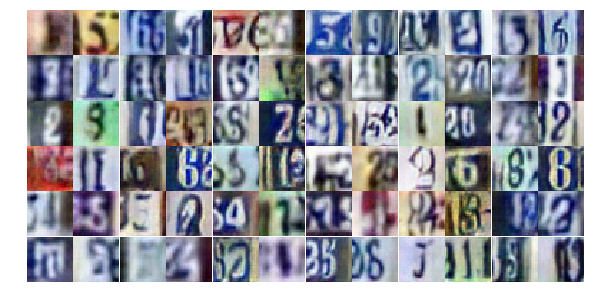

Epoch 22/25... Discriminator Loss: 0.4917... Generator Loss: 1.8352
Epoch 22/25... Discriminator Loss: 0.8027... Generator Loss: 0.8284
Epoch 22/25... Discriminator Loss: 0.8504... Generator Loss: 0.8344
Epoch 22/25... Discriminator Loss: 0.4405... Generator Loss: 1.4582
Epoch 22/25... Discriminator Loss: 0.5787... Generator Loss: 1.4419
Epoch 22/25... Discriminator Loss: 1.0961... Generator Loss: 1.2140
Epoch 22/25... Discriminator Loss: 0.7254... Generator Loss: 0.9676
Epoch 22/25... Discriminator Loss: 0.4866... Generator Loss: 1.4850
Epoch 22/25... Discriminator Loss: 0.6561... Generator Loss: 1.1978
Epoch 22/25... Discriminator Loss: 0.8137... Generator Loss: 1.0401


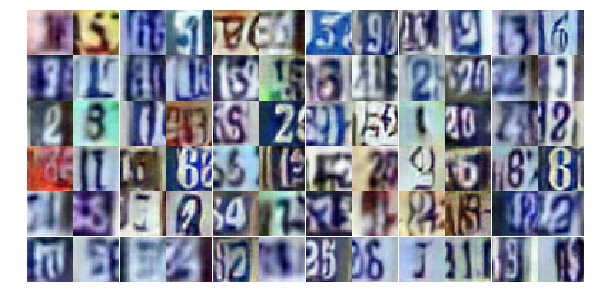

Epoch 22/25... Discriminator Loss: 0.6253... Generator Loss: 1.0895
Epoch 22/25... Discriminator Loss: 0.5998... Generator Loss: 1.2280
Epoch 22/25... Discriminator Loss: 1.0953... Generator Loss: 0.6677
Epoch 22/25... Discriminator Loss: 1.1765... Generator Loss: 0.5708
Epoch 22/25... Discriminator Loss: 0.8537... Generator Loss: 0.9787
Epoch 22/25... Discriminator Loss: 1.1302... Generator Loss: 0.7258
Epoch 22/25... Discriminator Loss: 1.7061... Generator Loss: 0.3190
Epoch 22/25... Discriminator Loss: 0.8184... Generator Loss: 1.3281
Epoch 22/25... Discriminator Loss: 1.2096... Generator Loss: 0.5495
Epoch 22/25... Discriminator Loss: 1.1729... Generator Loss: 0.6286


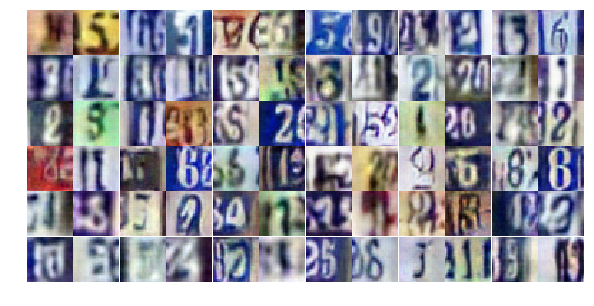

Epoch 22/25... Discriminator Loss: 0.8722... Generator Loss: 0.7911
Epoch 22/25... Discriminator Loss: 0.5685... Generator Loss: 1.6982
Epoch 22/25... Discriminator Loss: 0.4265... Generator Loss: 1.5591
Epoch 22/25... Discriminator Loss: 0.7691... Generator Loss: 0.9908
Epoch 22/25... Discriminator Loss: 0.6407... Generator Loss: 2.9429
Epoch 22/25... Discriminator Loss: 0.5939... Generator Loss: 1.0961
Epoch 22/25... Discriminator Loss: 0.7388... Generator Loss: 1.0873
Epoch 22/25... Discriminator Loss: 1.0118... Generator Loss: 0.7557
Epoch 22/25... Discriminator Loss: 1.1335... Generator Loss: 0.7016
Epoch 22/25... Discriminator Loss: 0.8198... Generator Loss: 0.8557


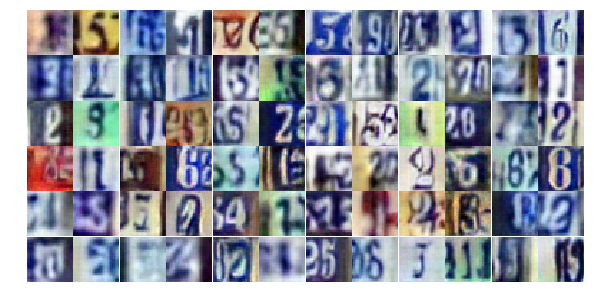

Epoch 22/25... Discriminator Loss: 1.0077... Generator Loss: 0.7064
Epoch 22/25... Discriminator Loss: 0.4676... Generator Loss: 1.5815
Epoch 22/25... Discriminator Loss: 1.3406... Generator Loss: 0.4442
Epoch 22/25... Discriminator Loss: 1.0103... Generator Loss: 0.6679
Epoch 22/25... Discriminator Loss: 0.8675... Generator Loss: 0.8941
Epoch 22/25... Discriminator Loss: 1.3136... Generator Loss: 0.4957
Epoch 22/25... Discriminator Loss: 0.7387... Generator Loss: 1.1169
Epoch 22/25... Discriminator Loss: 0.7685... Generator Loss: 0.9731
Epoch 22/25... Discriminator Loss: 1.0030... Generator Loss: 1.2032
Epoch 22/25... Discriminator Loss: 0.8360... Generator Loss: 1.1919


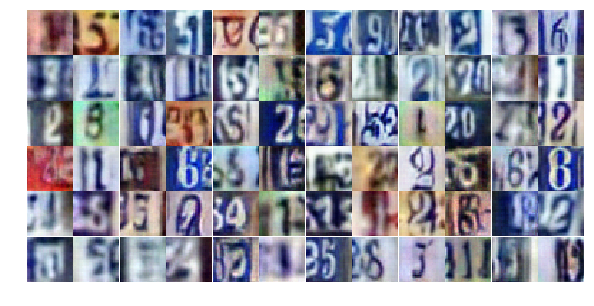

Epoch 23/25... Discriminator Loss: 0.5345... Generator Loss: 1.9215
Epoch 23/25... Discriminator Loss: 0.5305... Generator Loss: 1.3744
Epoch 23/25... Discriminator Loss: 0.7445... Generator Loss: 1.0078
Epoch 23/25... Discriminator Loss: 0.8852... Generator Loss: 0.7952
Epoch 23/25... Discriminator Loss: 0.8453... Generator Loss: 0.8344
Epoch 23/25... Discriminator Loss: 1.2776... Generator Loss: 0.4580
Epoch 23/25... Discriminator Loss: 1.6216... Generator Loss: 0.4246
Epoch 23/25... Discriminator Loss: 0.9912... Generator Loss: 0.6430
Epoch 23/25... Discriminator Loss: 0.7210... Generator Loss: 1.0105
Epoch 23/25... Discriminator Loss: 0.5735... Generator Loss: 1.2326


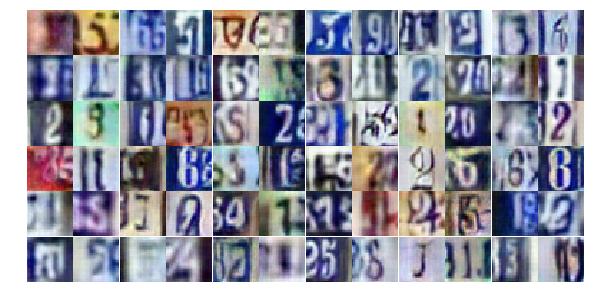

Epoch 23/25... Discriminator Loss: 0.7520... Generator Loss: 0.9608
Epoch 23/25... Discriminator Loss: 0.8945... Generator Loss: 0.7718
Epoch 23/25... Discriminator Loss: 0.9113... Generator Loss: 0.7654
Epoch 23/25... Discriminator Loss: 0.9223... Generator Loss: 0.7198
Epoch 23/25... Discriminator Loss: 0.7390... Generator Loss: 0.8882
Epoch 23/25... Discriminator Loss: 0.9287... Generator Loss: 0.7558
Epoch 23/25... Discriminator Loss: 0.9402... Generator Loss: 0.7544
Epoch 23/25... Discriminator Loss: 0.6251... Generator Loss: 1.3115
Epoch 23/25... Discriminator Loss: 1.5762... Generator Loss: 0.5194
Epoch 23/25... Discriminator Loss: 1.1121... Generator Loss: 0.5931


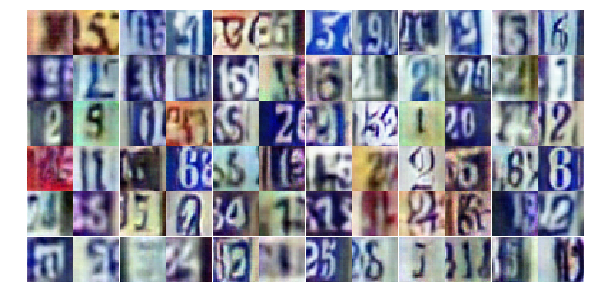

Epoch 23/25... Discriminator Loss: 1.3843... Generator Loss: 0.5226
Epoch 23/25... Discriminator Loss: 0.6365... Generator Loss: 1.1204
Epoch 23/25... Discriminator Loss: 0.7401... Generator Loss: 0.8978
Epoch 23/25... Discriminator Loss: 0.9170... Generator Loss: 0.7467
Epoch 23/25... Discriminator Loss: 0.8196... Generator Loss: 0.8808
Epoch 23/25... Discriminator Loss: 0.5890... Generator Loss: 1.2064
Epoch 23/25... Discriminator Loss: 0.9086... Generator Loss: 0.7352
Epoch 23/25... Discriminator Loss: 0.9283... Generator Loss: 0.7397
Epoch 23/25... Discriminator Loss: 0.9345... Generator Loss: 0.8066
Epoch 23/25... Discriminator Loss: 0.8740... Generator Loss: 0.9457


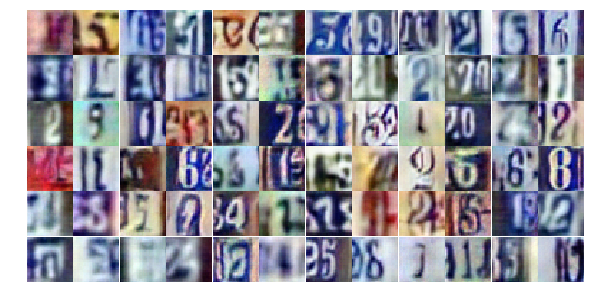

Epoch 23/25... Discriminator Loss: 0.5487... Generator Loss: 1.3011
Epoch 23/25... Discriminator Loss: 0.8040... Generator Loss: 0.9326
Epoch 23/25... Discriminator Loss: 0.6856... Generator Loss: 1.0029
Epoch 23/25... Discriminator Loss: 1.1615... Generator Loss: 0.5412
Epoch 23/25... Discriminator Loss: 0.9762... Generator Loss: 2.0592
Epoch 23/25... Discriminator Loss: 0.8098... Generator Loss: 0.8827
Epoch 23/25... Discriminator Loss: 1.2826... Generator Loss: 0.5663
Epoch 23/25... Discriminator Loss: 0.6672... Generator Loss: 1.0423
Epoch 23/25... Discriminator Loss: 0.4373... Generator Loss: 1.8475
Epoch 23/25... Discriminator Loss: 0.4855... Generator Loss: 1.3554


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))